# Holo2Bright with CycleGAN

We'll build a CycleGAN model to convert Holographic microscopy images to Brightfield microscopy images and vice versa.

## The Holo2Bright dataset

The Holo2Bright dataset consists of holographic and brightfield microscopy images of marine microplankton. The dataset consists of 4500 holographic images and 880 brightfield images for training, and 4500 holographic images and 244 brightfield images for testing. The dataset is available at [holo2bright_dataset](https://github.com/DeepTrackAI/holo2bright_dataset) GitHub repository. Instructions on how to download the dataset using `git clone` are available in the repository.

Once downloaded, the dataset can be used like any other dataset in torch using the custom `Holo2BrightDataset` class that is available in python file `dataset.py`.

Before we import the dataset into the notebook, we will define augmentations, transforms, and normalization that we will apply to the dataset. We will use the `torchvision.transforms` module for this purpose. The transforms we will apply are as follows:

1. We will create augmentations, horizontal flip and vertical flip, using the `torchvision.transforms` with probability 0.5. This will randomly flip the images and increase the size of the dataset on the fly.
2. We will normalize the pixel values of the images to be in between -1 and 1. 

This is standard requirement for CycleGAN as it uses tanh activation in the output layer. We will see more on the models later it this notebook.

In [1]:
from torchvision import transforms

transform = [
    # transforms for holographic images
    transforms.Compose([
        # Add augmentation here
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.RandomVerticalFlip(p=0.5),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5], std=[0.5])
    ]),

    # transforms for brightfield images
    transforms.Compose([
        # Add augmentation here
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.RandomVerticalFlip(p=0.5),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
]

We will now import the class `Holo2BrightDataset` from `dataset.py` and create the train and test datasets. The `Holo2Bright` dataset takes the arguments, `root`, `train`, and `transform`.

Here, `root` is the path to the dataset folder. It is the path of the folder what the [holo2bright_dataset](https://github.com/DeepTrackAI/holo2bright_dataset) is cloned.

The `train` argument is a boolean value that indicates whether the dataset is for training or testing. If `train` is `True`, the dataset will be used for training, and if `train` is `False`, the dataset will be used for testing.

The `transform` argument accepts the transformations we have create in the above cell.

Since we have low number of brightfiled images than holographic images, the length of the dataset is restricted to the number of brightfield images.

In [2]:
from dataset import Holo2BrightDataset

root = '../holo2bright_dataset' # Change the path accordingly

train_dataset = Holo2BrightDataset(root, train=True, transform=transform)
test_dataset = Holo2BrightDataset(root, train=False, transform=transform)

print(len(train_dataset))
print(len(test_dataset))

880
244


We can now visualize some images from the training dataset using the `matplotlib` package.

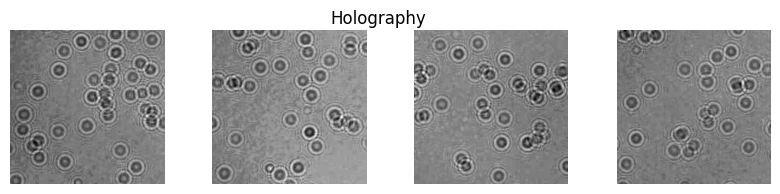

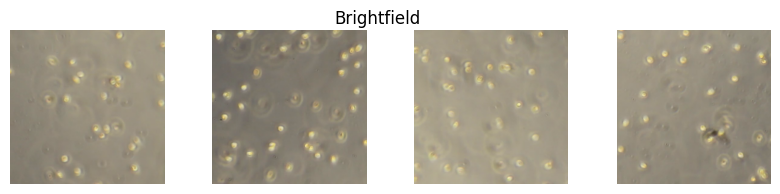

In [3]:
import matplotlib.pyplot as plt
import numpy as np

def denormalize_data(img, mean=0.5, std=0.5):
    img = (img * std) + mean
    img = img * 255.0
    img = img.astype(np.uint8)
    return img

fig, ax = plt.subplots(1, 4, figsize=(10, 2))
for i in range(4):
    im = ax[i].imshow(train_dataset[i][0][0], cmap="gray")
    ax[i].axis("off")
fig.suptitle("Holography")
plt.show()

fig, ax = plt.subplots(1, 4, figsize=(10, 2))
for i in range(4):
    ax[i].imshow(denormalize_data(train_dataset[i][1].permute(1, 2, 0).numpy()))
    ax[i].axis("off")
fig.suptitle("Brightfield")
plt.show()

We now define the `device` to be used for training the model. We will use the GPU if it's available, otherwise we will use the CPU. The `torch.cuda.is_available()` function returns `True` if the GPU is available, otherwise it returns `False`.

In [4]:
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## CycleGAN Generator and Discriminator

In this section we define the generator and discriminator networks of the CycleGAN model.

### Generator

We use the class `CycleGANGenerator` from `deeplay` to define the CycleGAN generator network. It takes an image of shape `(batch_size, channels, height, width)` as input and returns an image of the same shape as output. The number of channels in the input and output images can be different. The `CycleGANGenerator` class takes the following arguments:

1. `in_channels`: The number of channels in the input image.
2. `out_channels`: The number of channels in the output image.

We will create two generator networks for two different transformations.

1. `generator_H2B` for the transforming holographic images to brightfield images.
2. `generator_B2H` for the transforming brightfield images to holographic images.

Once defined, we will pass the networks to the `device` defined above.

In [5]:
import deeplay as dl

generator_H2B = dl.CycleGANGenerator(in_channels=1, out_channels=3).build()
generator_B2H = dl.CycleGANGenerator(in_channels=3, out_channels=1).build()

generator_H2B.to(device)
generator_B2H.to(device)

CycleGANGenerator(
  (blocks): LayerList(
    (0): CycleGANBlock(
      (layer): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), padding_mode=reflect)
      (normalization): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): ReLU()
    )
    (1): CycleGANBlock(
      (layer): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
      (normalization): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): ReLU()
    )
    (2): CycleGANBlock(
      (layer): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
      (normalization): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): ReLU()
    )
    (3-11): 9 x ResidualBlock(
      (blocks): LayerList(
        (0): CycleGANBlock(
          (layer): Conv2d(256, 256, kernel_size=(3, 3), stride=(

### Discriminator

We will use the class `CycleGANDiscriminator` from `deeplay` to define the CycleGAN discriminator network. The network takes an image of shape `(batch_size, channels, height, width)` as input and returns a scalar value as output. Hence, the `CycleGANDiscriminator` class a single argument `in_channels` which is the number of channels in the input image.

We will create two discriminator networks for two different transformations.

1. `discriminator_H` for discriminating the real and fake holographic images.
2. `discriminator_B` for discriminating the real and fake brightfield images.

Once created, we will both the networks to the `device` defined above.

In [6]:
discriminator_H = dl.CycleGANDiscriminator(in_channels=1).build()
discriminator_B = dl.CycleGANDiscriminator(in_channels=3).build()

discriminator_H.to(device)
discriminator_B.to(device)

CycleGANDiscriminator(
  (blocks): LayerList(
    (0): PatchGANBlock(
      (layer): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
      (normalization): Identity()
      (activation): LeakyReLU(negative_slope=0.2)
    )
    (1): PatchGANBlock(
      (layer): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
      (normalization): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): LeakyReLU(negative_slope=0.2)
    )
    (2): PatchGANBlock(
      (layer): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
      (normalization): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): LeakyReLU(negative_slope=0.2)
    )
    (3): PatchGANBlock(
      (layer): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), padding_mode=reflect)
      (normalization):

## Loss functions
We define two different loss functions for generators and discriminators.

The generator loss function named as `loss_G` is mean absolute error or also called as L1 loss.
The discriminator loss function named as `loss_D` is binary cross entropy loss.

In [7]:
# Loss functions
Loss_D = torch.nn.MSELoss()
Loss_G = torch.nn.L1Loss()

## Optimizers
We will define two different optimizers for both the generators and both the discriminators.
Which means during the backpropagation step, both the generators are trained togehter and both the discriminators are trained togehter.

The learning defined by the `lr` parameter is set to 0.0002 for both the optimizers. And the `betas` parameter is set to `(0.5, 0.999)`. The `betas` are used for computing the running averages of the gradient and its square internally during the training process.

In [8]:
# Optimizers (combined for both generators and discriminators)
optimizer_G = torch.optim.Adam(
    list(generator_H2B.parameters()) + list(generator_B2H.parameters()),
    lr=0.0002,
    betas=(0.5, 0.999),
)

optimizer_D = torch.optim.Adam(
    list(discriminator_H.parameters()) + list(discriminator_B.parameters()),
    lr=0.0002,
    betas=(0.5, 0.999),
)


## Dataloaders

We now define the data loaders for the training and test datasets. We will use a batch size of 8 as defined by the `batch_size` parameter for the train dataset and batch size of 1 for the dataset as it is only for evaluation. We will also set the `shuffle` parameter to `True` to shuffle the training dataset before creating batches. Note the these parameters can be changed according to computational resources available.

In [9]:
trainloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)
testloader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=True)

## Training procedure

We will now define the training procedure for the CycleGAN. We will split into three parts where we create two funtions `train_model` and `evaluate_model` for defining the training and evaluation procedures respectively. Then we will create a training loop in the end where we will use both the functions.

### Training function

We will define the function `train_model` to implement the training procedure for CycleGAN. The function `train_model` takes the input images belonging to both domains as arguments, along with the optimizers, and the loss co-efficients, `L1_Lambda_A` and `L1_Lambda_B`. It returns the losses computed for the generators and discriminator. 

We will use this function during every epoch of the training loop.

In [10]:
# Training
def train_model(
    input_image_H, input_image_B, optimizer_disc, optimizer_gen, L1_LambdaH, L1_LambdaB
):

    # zero the parameter gradients
    optimizer_disc.zero_grad()

    # 1. Training both the discriminators

    # Train discriminator B (As a part of the trasnformation Holography -> Brightfield)
    fake_image_B = generator_H2B(input_image_H)
    disc_B_real = discriminator_B(input_image_B)
    disc_B_fake = discriminator_B(fake_image_B.detach())

    disc_B_loss_real = Loss_D(disc_B_real, torch.ones_like(disc_B_real))
    disc_B_loss_fake = Loss_D(disc_B_fake, torch.zeros_like(disc_B_fake))

    disc_B_loss = disc_B_loss_real + disc_B_loss_fake

    # Train discriminator H (As a part of the trasnformation Brightfield -> Holography)
    fake_image_H = generator_B2H(input_image_B)
    disc_H_real = discriminator_H(input_image_H)
    disc_H_fake = discriminator_H(fake_image_H.detach())

    disc_H_loss_real = Loss_D(disc_H_real, torch.ones_like(disc_H_real))
    disc_H_loss_fake = Loss_D(disc_H_fake, torch.zeros_like(disc_H_fake))

    disc_H_loss = disc_H_loss_real + disc_H_loss_fake

    # Total discriminator loss
    disc_loss = (disc_B_loss + disc_H_loss) / 2

    # Backpropagate
    disc_loss.backward()

    # Update weights
    optimizer_disc.step()

    # 2. Training both the generators for each discriminator training

    # Train generators
    disc_B_fake = discriminator_B(fake_image_B)
    disc_H_fake = discriminator_H(fake_image_H)

    # Adversarial loss (from generators perspective)
    gen_H2B_loss = Loss_D(disc_B_fake, torch.ones_like(disc_B_fake))
    gen_B2H_loss = Loss_D(disc_H_fake, torch.ones_like(disc_H_fake))

    # zero the parameter gradients
    optimizer_gen.zero_grad()

    # 3. Cycle consistency loss
    cycle_H = generator_B2H(fake_image_B)
    cycle_B = generator_H2B(fake_image_H)
    cycle_H_loss = Loss_G(input_image_H, cycle_H)
    cycle_B_loss = Loss_G(input_image_B, cycle_B)

    # Total generator loss
    gen_loss = (
        gen_H2B_loss
        + gen_B2H_loss
        + L1_LambdaH * cycle_H_loss
        + L1_LambdaB * cycle_B_loss
    )

    # Backpropagate
    gen_loss.backward()

    # Update weights
    optimizer_gen.step()

    return disc_loss, gen_loss

### Evaluate model function

We will define the function `evaluate_model` to implement the evaluation procedure for CycleGAN. The function `evaluate_model` takes the input images belong to both the domains, `image_H`, and `image_B`, as arguments and returns the figures of the generated images of the opposite domains, `fake_B`, and `fake_H`, respectively.

We will use this function during every epoch of the training loop to visualize the generated images.

In [11]:
def evaluate_model(image_H, image_B):
    generator_H2B.eval()
    generator_B2H.eval()

    fake_image_B = generator_H2B(image_H)
    fake_image_H = generator_B2H(image_B)

    generator_H2B.train()
    generator_B2H.train()

    # plot the images
    fig, ax = plt.subplots(2, 2, figsize=(5,5))

    # plot color image
    ax[0, 0].imshow(
        image_H[0].permute(1, 2, 0).cpu().detach().numpy(), cmap="gray"
    )
    ax[0, 0].set_title("Input: Holographic image", fontsize=8)
    ax[0, 0].axis("off")

    ax[1, 0].imshow(
        denormalize_data(image_B[0].permute(1, 2, 0).cpu().detach().numpy())
    )
    ax[1, 0].set_title("Input: Brightfield image", fontsize=8)
    ax[1, 0].axis("off")

    ax[0, 1].imshow(
        denormalize_data(fake_image_B[0].permute(1, 2, 0).cpu().detach().numpy())
    )
    ax[0, 1].set_title("Output: Brightfield image", fontsize=8)
    ax[0, 1].axis("off")

    ax[1, 1].imshow(
        fake_image_H[0].permute(1, 2, 0).cpu().detach().numpy(), cmap="gray"
    )
    ax[1, 1].set_title("Output: Holographic image", fontsize=8)
    ax[1, 1].axis("off")

    return fig

### Training loop

Here, we will use the functions, `train_model` and `evaluate_model`, defined above to create a training loop. We will train the model for 100 epochs. We will also plot the results every epoch.



Epoch 1/100
----------


Batch 1/110 : Generator Loss: 7.0843, Discriminator Loss: 0.5261
Batch 21/110 : Generator Loss: 2.0986, Discriminator Loss: 0.4275
Batch 41/110 : Generator Loss: 2.5146, Discriminator Loss: 0.3829
Batch 61/110 : Generator Loss: 2.2209, Discriminator Loss: 0.4011
Batch 81/110 : Generator Loss: 2.4457, Discriminator Loss: 0.2145
Batch 101/110 : Generator Loss: 2.2931, Discriminator Loss: 0.2045
----------
Epoch 1/100 : Generator Loss: 2.4164, Discriminator Loss: 0.3411
Time taken: 0:00:35.205324


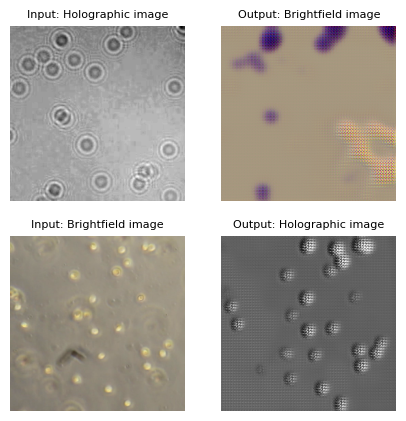



Epoch 2/100
----------
Batch 1/110 : Generator Loss: 2.8051, Discriminator Loss: 0.1906
Batch 21/110 : Generator Loss: 2.5143, Discriminator Loss: 0.1637
Batch 41/110 : Generator Loss: 2.3694, Discriminator Loss: 0.1640
Batch 61/110 : Generator Loss: 2.3006, Discriminator Loss: 0.2382
Batch 81/110 : Generator Loss: 2.4147, Discriminator Loss: 0.1472
Batch 101/110 : Generator Loss: 2.5002, Discriminator Loss: 0.1103
----------
Epoch 2/100 : Generator Loss: 2.5125, Discriminator Loss: 0.1845
Time taken: 0:00:34.883668


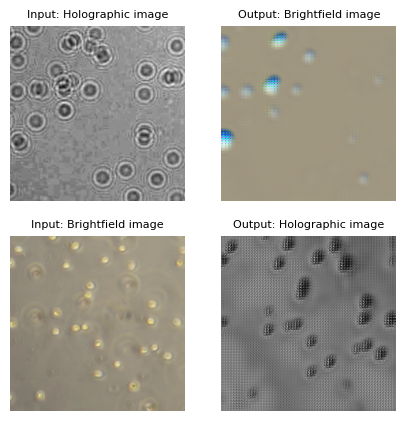



Epoch 3/100
----------
Batch 1/110 : Generator Loss: 2.7643, Discriminator Loss: 0.0938
Batch 21/110 : Generator Loss: 2.7300, Discriminator Loss: 0.2283
Batch 41/110 : Generator Loss: 2.6022, Discriminator Loss: 0.0595
Batch 61/110 : Generator Loss: 2.6706, Discriminator Loss: 0.0538
Batch 81/110 : Generator Loss: 2.6545, Discriminator Loss: 0.0373
Batch 101/110 : Generator Loss: 2.6047, Discriminator Loss: 0.0439
----------
Epoch 3/100 : Generator Loss: 2.6424, Discriminator Loss: 0.0702
Time taken: 0:00:35.013238


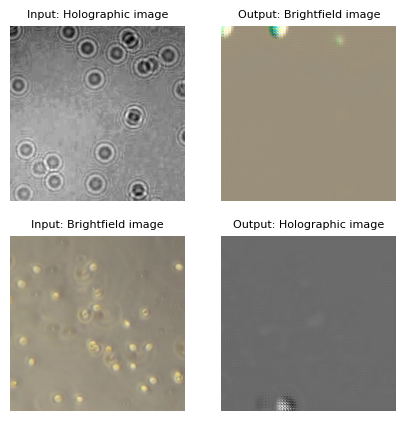



Epoch 4/100
----------
Batch 1/110 : Generator Loss: 2.6378, Discriminator Loss: 0.0409
Batch 21/110 : Generator Loss: 2.5434, Discriminator Loss: 0.0385
Batch 41/110 : Generator Loss: 2.5313, Discriminator Loss: 0.0709
Batch 61/110 : Generator Loss: 2.7780, Discriminator Loss: 0.0391
Batch 81/110 : Generator Loss: 2.7452, Discriminator Loss: 0.0258
Batch 101/110 : Generator Loss: 2.5338, Discriminator Loss: 0.0310
----------
Epoch 4/100 : Generator Loss: 2.6352, Discriminator Loss: 0.0416
Time taken: 0:00:34.974819


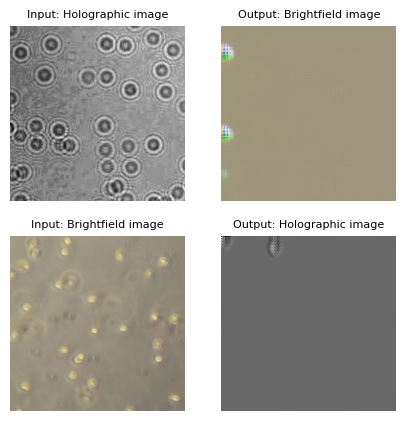



Epoch 5/100
----------
Batch 1/110 : Generator Loss: 2.7387, Discriminator Loss: 0.0304
Batch 21/110 : Generator Loss: 2.7597, Discriminator Loss: 0.0261
Batch 41/110 : Generator Loss: 2.6492, Discriminator Loss: 0.0424
Batch 61/110 : Generator Loss: 2.6635, Discriminator Loss: 0.0292
Batch 81/110 : Generator Loss: 2.8930, Discriminator Loss: 0.0148
Batch 101/110 : Generator Loss: 2.8509, Discriminator Loss: 0.0279
----------
Epoch 5/100 : Generator Loss: 2.6982, Discriminator Loss: 0.0446
Time taken: 0:00:35.054430


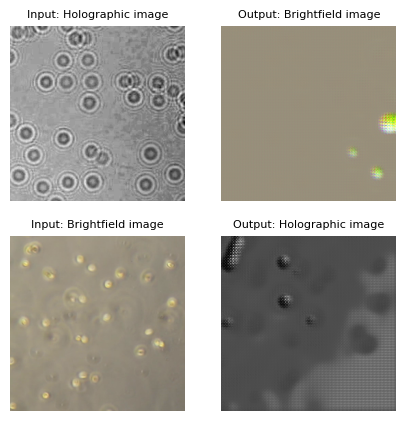



Epoch 6/100
----------
Batch 1/110 : Generator Loss: 2.7262, Discriminator Loss: 0.2025
Batch 21/110 : Generator Loss: 2.5430, Discriminator Loss: 0.0291
Batch 41/110 : Generator Loss: 2.9655, Discriminator Loss: 0.0136
Batch 61/110 : Generator Loss: 2.5153, Discriminator Loss: 0.0133
Batch 81/110 : Generator Loss: 2.6105, Discriminator Loss: 0.0124
Batch 101/110 : Generator Loss: 2.6003, Discriminator Loss: 0.0094
----------
Epoch 6/100 : Generator Loss: 2.6570, Discriminator Loss: 0.0220
Time taken: 0:00:35.002795


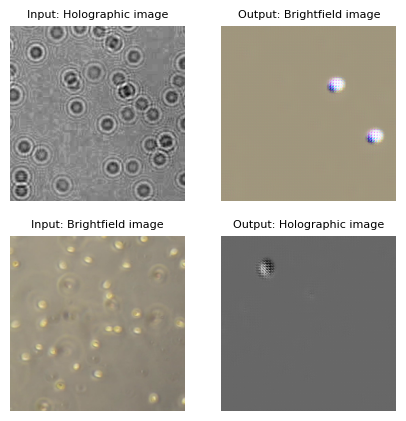



Epoch 7/100
----------
Batch 1/110 : Generator Loss: 2.6881, Discriminator Loss: 0.0082
Batch 21/110 : Generator Loss: 2.7831, Discriminator Loss: 0.0088
Batch 41/110 : Generator Loss: 2.6603, Discriminator Loss: 0.0050
Batch 61/110 : Generator Loss: 2.7229, Discriminator Loss: 0.0047
Batch 81/110 : Generator Loss: 2.5096, Discriminator Loss: 0.0550
Batch 101/110 : Generator Loss: 2.7929, Discriminator Loss: 0.0882
----------
Epoch 7/100 : Generator Loss: 2.6695, Discriminator Loss: 0.0185
Time taken: 0:00:35.068542


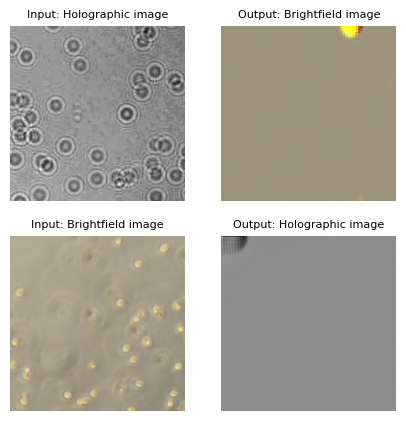



Epoch 8/100
----------
Batch 1/110 : Generator Loss: 2.6098, Discriminator Loss: 0.0189
Batch 21/110 : Generator Loss: 2.7248, Discriminator Loss: 0.0060
Batch 41/110 : Generator Loss: 2.5502, Discriminator Loss: 0.1675
Batch 61/110 : Generator Loss: 2.4861, Discriminator Loss: 0.0763
Batch 81/110 : Generator Loss: 2.9600, Discriminator Loss: 0.2164
Batch 101/110 : Generator Loss: 2.7373, Discriminator Loss: 0.0609
----------
Epoch 8/100 : Generator Loss: 2.7301, Discriminator Loss: 0.1432
Time taken: 0:00:34.902645


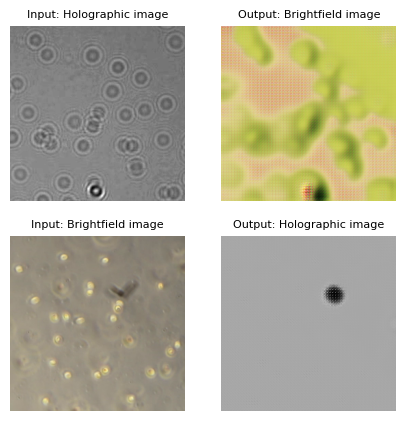



Epoch 9/100
----------
Batch 1/110 : Generator Loss: 2.7515, Discriminator Loss: 0.0632
Batch 21/110 : Generator Loss: 2.6563, Discriminator Loss: 0.1026
Batch 41/110 : Generator Loss: 2.9225, Discriminator Loss: 0.1999
Batch 61/110 : Generator Loss: 3.0477, Discriminator Loss: 0.1006
Batch 81/110 : Generator Loss: 2.7359, Discriminator Loss: 0.0888
Batch 101/110 : Generator Loss: 2.7339, Discriminator Loss: 0.0474
----------
Epoch 9/100 : Generator Loss: 2.7751, Discriminator Loss: 0.1026
Time taken: 0:00:35.044891


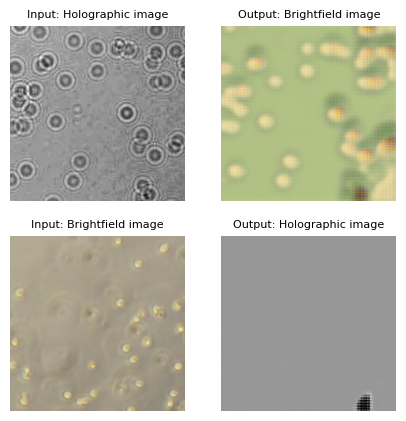



Epoch 10/100
----------
Batch 1/110 : Generator Loss: 2.8231, Discriminator Loss: 0.0378
Batch 21/110 : Generator Loss: 3.0617, Discriminator Loss: 0.0514
Batch 41/110 : Generator Loss: 2.8257, Discriminator Loss: 0.0358
Batch 61/110 : Generator Loss: 2.8980, Discriminator Loss: 0.0478
Batch 101/110 : Generator Loss: 2.7821, Discriminator Loss: 0.0954
----------
Epoch 13/100 : Generator Loss: 2.7314, Discriminator Loss: 0.1068
Time taken: 0:00:35.049384


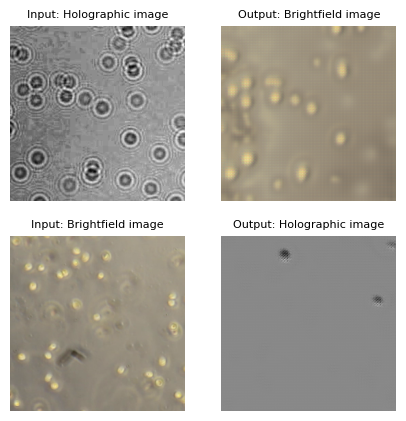



Epoch 14/100
----------
Batch 1/110 : Generator Loss: 2.5940, Discriminator Loss: 0.0975
Batch 21/110 : Generator Loss: 2.6848, Discriminator Loss: 0.0437
Batch 41/110 : Generator Loss: 2.8699, Discriminator Loss: 0.0384
Batch 61/110 : Generator Loss: 2.7970, Discriminator Loss: 0.0453
Batch 81/110 : Generator Loss: 2.7636, Discriminator Loss: 0.0453
Batch 101/110 : Generator Loss: 2.8808, Discriminator Loss: 0.0698
----------
Epoch 14/100 : Generator Loss: 2.7997, Discriminator Loss: 0.0685
Time taken: 0:00:35.027820


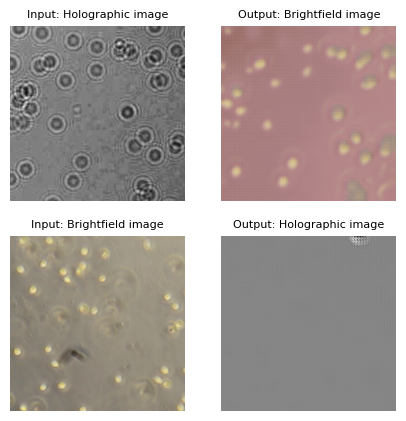



Epoch 15/100
----------
Batch 1/110 : Generator Loss: 2.4206, Discriminator Loss: 0.4932
Batch 21/110 : Generator Loss: 2.6773, Discriminator Loss: 0.3985
Batch 41/110 : Generator Loss: 2.8371, Discriminator Loss: 0.0531
Batch 61/110 : Generator Loss: 2.7492, Discriminator Loss: 0.1642
Batch 81/110 : Generator Loss: 2.8183, Discriminator Loss: 0.0446
Batch 101/110 : Generator Loss: 2.8132, Discriminator Loss: 0.0425
----------
Epoch 15/100 : Generator Loss: 2.7301, Discriminator Loss: 0.1303
Time taken: 0:00:35.005640


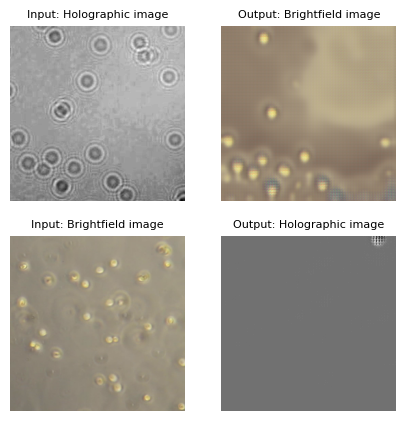



Epoch 16/100
----------
Batch 1/110 : Generator Loss: 2.5932, Discriminator Loss: 0.0532
Batch 21/110 : Generator Loss: 2.6321, Discriminator Loss: 0.1125
Batch 41/110 : Generator Loss: 2.5866, Discriminator Loss: 0.1200
Batch 61/110 : Generator Loss: 2.6162, Discriminator Loss: 0.0675
Batch 81/110 : Generator Loss: 2.7495, Discriminator Loss: 0.0549
Batch 101/110 : Generator Loss: 2.6825, Discriminator Loss: 0.1697
----------
Epoch 16/100 : Generator Loss: 2.7084, Discriminator Loss: 0.0952
Time taken: 0:00:34.988498


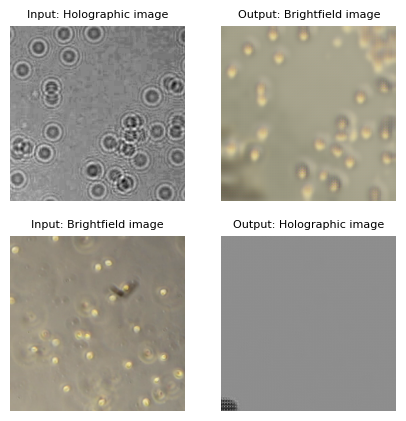



Epoch 17/100
----------
Batch 1/110 : Generator Loss: 2.6576, Discriminator Loss: 0.0952
Batch 21/110 : Generator Loss: 2.7655, Discriminator Loss: 0.1128
Batch 41/110 : Generator Loss: 2.6656, Discriminator Loss: 0.1108
Batch 61/110 : Generator Loss: 2.6074, Discriminator Loss: 0.0521
Batch 81/110 : Generator Loss: 2.7820, Discriminator Loss: 0.1090
Batch 101/110 : Generator Loss: 2.8116, Discriminator Loss: 0.0710
----------
Epoch 17/100 : Generator Loss: 2.7175, Discriminator Loss: 0.0819
Time taken: 0:00:34.989984


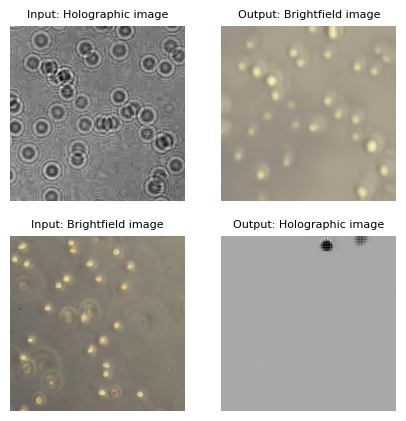



Epoch 18/100
----------
Batch 1/110 : Generator Loss: 2.6899, Discriminator Loss: 0.0490
Batch 21/110 : Generator Loss: 2.6336, Discriminator Loss: 0.0343
Batch 41/110 : Generator Loss: 2.8259, Discriminator Loss: 0.0486
Batch 61/110 : Generator Loss: 2.5248, Discriminator Loss: 0.1169
Batch 81/110 : Generator Loss: 2.7382, Discriminator Loss: 0.1035
Batch 101/110 : Generator Loss: 2.7931, Discriminator Loss: 0.0710
----------
Epoch 18/100 : Generator Loss: 2.6991, Discriminator Loss: 0.0983
Time taken: 0:00:35.034746


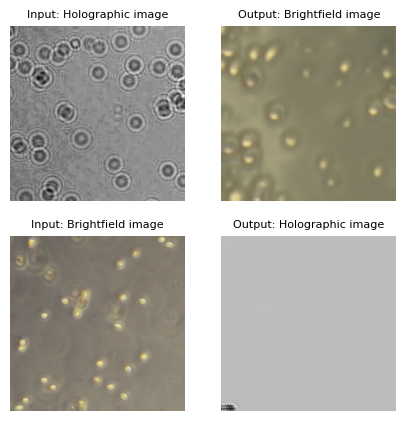



Epoch 19/100
----------
Batch 1/110 : Generator Loss: 2.6221, Discriminator Loss: 0.0482
Batch 21/110 : Generator Loss: 2.7362, Discriminator Loss: 0.1327
Batch 41/110 : Generator Loss: 2.6172, Discriminator Loss: 0.1351
Batch 61/110 : Generator Loss: 2.5776, Discriminator Loss: 0.0827
Batch 81/110 : Generator Loss: 2.8638, Discriminator Loss: 0.0367
Batch 101/110 : Generator Loss: 2.8501, Discriminator Loss: 0.0493
----------
Epoch 19/100 : Generator Loss: 2.7052, Discriminator Loss: 0.0989
Time taken: 0:00:35.077082


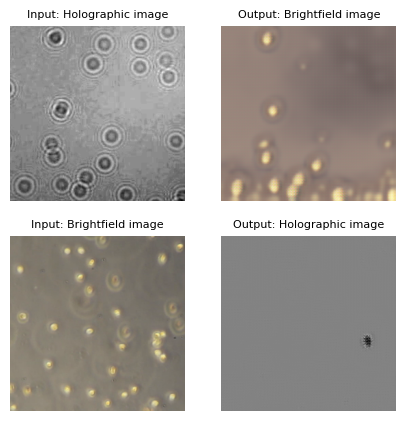



Epoch 20/100
----------
Batch 1/110 : Generator Loss: 2.6820, Discriminator Loss: 0.0521
Batch 21/110 : Generator Loss: 2.7997, Discriminator Loss: 0.0534
Batch 41/110 : Generator Loss: 2.7340, Discriminator Loss: 0.2005
Batch 61/110 : Generator Loss: 2.7585, Discriminator Loss: 0.1047
Batch 81/110 : Generator Loss: 2.6634, Discriminator Loss: 0.0212
Batch 101/110 : Generator Loss: 2.7823, Discriminator Loss: 0.0228
----------
Epoch 20/100 : Generator Loss: 2.7308, Discriminator Loss: 0.0608
Time taken: 0:00:35.113392


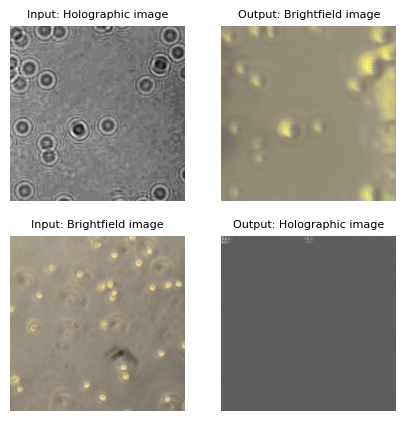



Epoch 21/100
----------
Batch 1/110 : Generator Loss: 2.6539, Discriminator Loss: 0.0189
Batch 21/110 : Generator Loss: 2.6539, Discriminator Loss: 0.0339
Batch 41/110 : Generator Loss: 2.6698, Discriminator Loss: 0.0235
Batch 61/110 : Generator Loss: 2.8201, Discriminator Loss: 0.0309
Batch 81/110 : Generator Loss: 2.6691, Discriminator Loss: 0.0691
Batch 101/110 : Generator Loss: 2.8223, Discriminator Loss: 0.0245
----------
Epoch 21/100 : Generator Loss: 2.7147, Discriminator Loss: 0.0438
Time taken: 0:00:35.132421


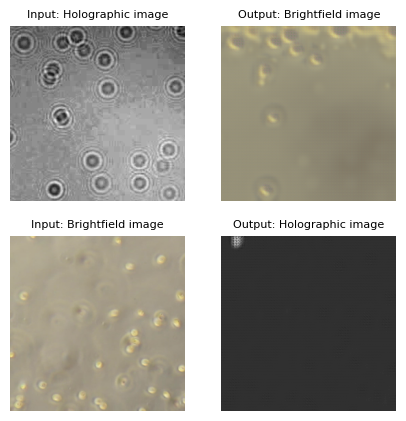



Epoch 22/100
----------
Batch 1/110 : Generator Loss: 2.8045, Discriminator Loss: 0.0347
Batch 21/110 : Generator Loss: 2.6606, Discriminator Loss: 0.0255
Batch 41/110 : Generator Loss: 2.6545, Discriminator Loss: 0.0311
Batch 61/110 : Generator Loss: 2.7150, Discriminator Loss: 0.0372
Batch 81/110 : Generator Loss: 2.7915, Discriminator Loss: 0.0426
Batch 101/110 : Generator Loss: 2.5169, Discriminator Loss: 0.0460
----------
Epoch 22/100 : Generator Loss: 2.7052, Discriminator Loss: 0.0527
Time taken: 0:00:35.095671


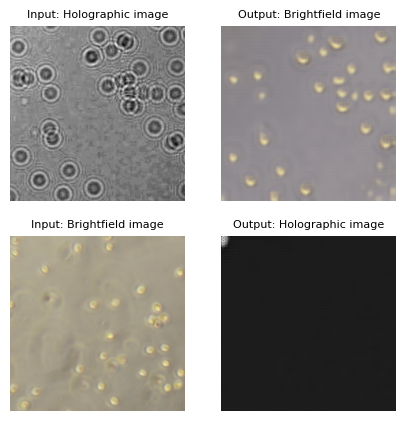



Epoch 23/100
----------
Batch 1/110 : Generator Loss: 2.7471, Discriminator Loss: 0.0392
Batch 21/110 : Generator Loss: 2.8836, Discriminator Loss: 0.0563
Batch 41/110 : Generator Loss: 2.8003, Discriminator Loss: 0.2131
Batch 61/110 : Generator Loss: 2.5713, Discriminator Loss: 0.0545
Batch 81/110 : Generator Loss: 2.4729, Discriminator Loss: 0.0546
Batch 101/110 : Generator Loss: 2.6771, Discriminator Loss: 0.1227
----------
Epoch 23/100 : Generator Loss: 2.6735, Discriminator Loss: 0.0881
Time taken: 0:00:35.102583


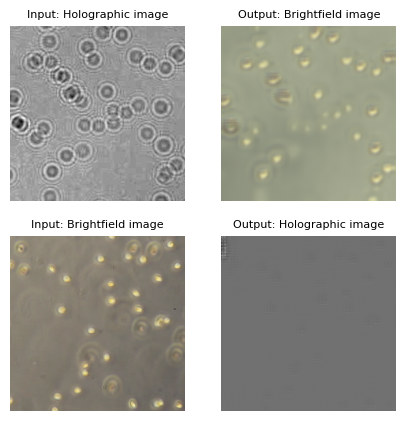



Epoch 24/100
----------
Batch 1/110 : Generator Loss: 2.6826, Discriminator Loss: 0.1495
Batch 21/110 : Generator Loss: 2.6157, Discriminator Loss: 0.0490
Batch 41/110 : Generator Loss: 2.6602, Discriminator Loss: 0.0361
Batch 61/110 : Generator Loss: 2.7393, Discriminator Loss: 0.0679
Batch 81/110 : Generator Loss: 2.6236, Discriminator Loss: 0.1403
Batch 101/110 : Generator Loss: 2.5998, Discriminator Loss: 0.0635
----------
Epoch 24/100 : Generator Loss: 2.6491, Discriminator Loss: 0.0816
Time taken: 0:00:35.053883


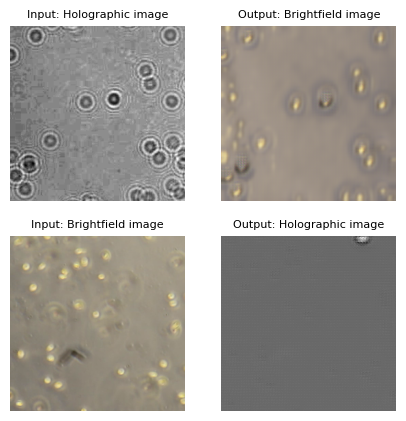



Epoch 25/100
----------
Batch 1/110 : Generator Loss: 2.5071, Discriminator Loss: 0.4164
Batch 21/110 : Generator Loss: 2.6746, Discriminator Loss: 0.0466
Batch 41/110 : Generator Loss: 2.7486, Discriminator Loss: 0.0501
Batch 61/110 : Generator Loss: 2.6260, Discriminator Loss: 0.0280
Batch 81/110 : Generator Loss: 2.6504, Discriminator Loss: 0.0931
Batch 101/110 : Generator Loss: 2.5520, Discriminator Loss: 0.0238
----------
Epoch 25/100 : Generator Loss: 2.6339, Discriminator Loss: 0.0840
Time taken: 0:00:34.960417


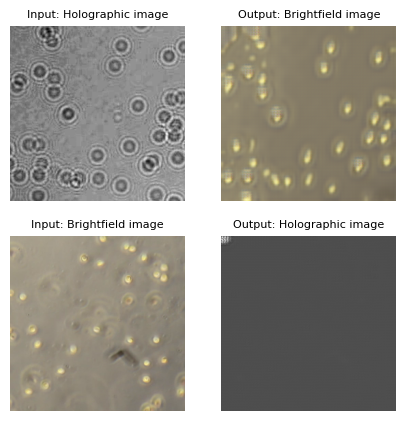



Epoch 26/100
----------
Batch 1/110 : Generator Loss: 2.5587, Discriminator Loss: 0.0463
Batch 21/110 : Generator Loss: 2.5887, Discriminator Loss: 0.0983
Batch 41/110 : Generator Loss: 2.6211, Discriminator Loss: 0.0319
Batch 61/110 : Generator Loss: 2.8249, Discriminator Loss: 0.0326
Batch 81/110 : Generator Loss: 2.6702, Discriminator Loss: 0.0753
Batch 101/110 : Generator Loss: 2.5479, Discriminator Loss: 0.0354
----------
Epoch 26/100 : Generator Loss: 2.6423, Discriminator Loss: 0.0520
Time taken: 0:00:35.090362


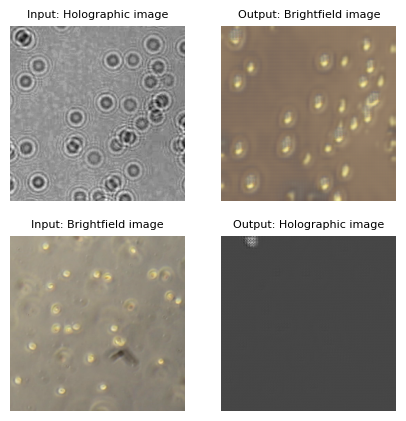



Epoch 27/100
----------
Batch 1/110 : Generator Loss: 2.7188, Discriminator Loss: 0.0348
Batch 21/110 : Generator Loss: 2.5545, Discriminator Loss: 0.1033
Batch 41/110 : Generator Loss: 2.7389, Discriminator Loss: 0.0196
Batch 61/110 : Generator Loss: 2.7103, Discriminator Loss: 0.0523
Batch 81/110 : Generator Loss: 2.8480, Discriminator Loss: 0.0381
Batch 101/110 : Generator Loss: 2.7041, Discriminator Loss: 0.0579
----------
Epoch 27/100 : Generator Loss: 2.6713, Discriminator Loss: 0.0425
Time taken: 0:00:35.090860


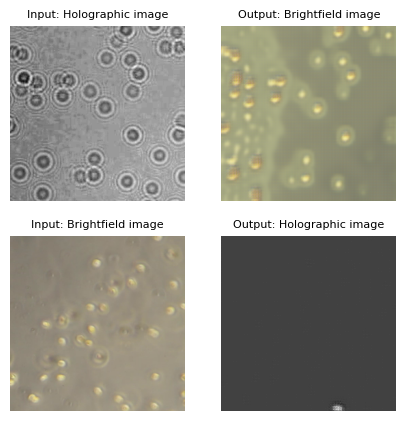



Epoch 28/100
----------
Batch 1/110 : Generator Loss: 2.6909, Discriminator Loss: 0.0362
Batch 21/110 : Generator Loss: 2.7520, Discriminator Loss: 0.0240
Batch 41/110 : Generator Loss: 2.5920, Discriminator Loss: 0.0318
Batch 61/110 : Generator Loss: 2.9354, Discriminator Loss: 0.1846
Batch 81/110 : Generator Loss: 2.9212, Discriminator Loss: 0.0265
Batch 101/110 : Generator Loss: 2.8191, Discriminator Loss: 0.0273
----------
Epoch 28/100 : Generator Loss: 2.7744, Discriminator Loss: 0.0550
Time taken: 0:00:35.111506


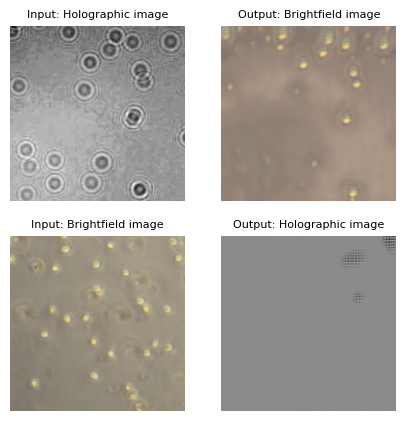



Epoch 29/100
----------
Batch 1/110 : Generator Loss: 2.5990, Discriminator Loss: 0.0486
Batch 21/110 : Generator Loss: 2.2392, Discriminator Loss: 0.1115
Batch 41/110 : Generator Loss: 2.7603, Discriminator Loss: 0.0294
Batch 61/110 : Generator Loss: 2.9189, Discriminator Loss: 0.0350
Batch 81/110 : Generator Loss: 2.8116, Discriminator Loss: 0.0419
Batch 101/110 : Generator Loss: 2.7263, Discriminator Loss: 0.0487
----------
Epoch 29/100 : Generator Loss: 2.7167, Discriminator Loss: 0.0459
Time taken: 0:00:35.112540


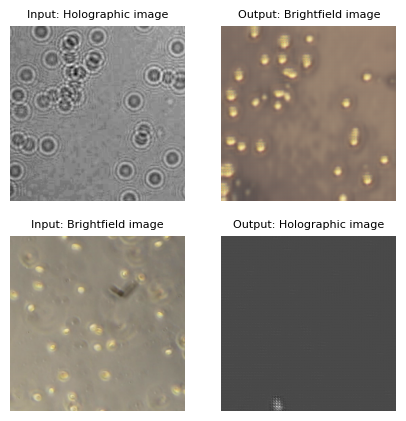



Epoch 30/100
----------
Batch 1/110 : Generator Loss: 2.5720, Discriminator Loss: 0.0210
Batch 21/110 : Generator Loss: 2.5564, Discriminator Loss: 0.0203
Batch 41/110 : Generator Loss: 2.3959, Discriminator Loss: 0.0985
Batch 61/110 : Generator Loss: 2.7787, Discriminator Loss: 0.0433
Batch 81/110 : Generator Loss: 2.6110, Discriminator Loss: 0.0583
Batch 101/110 : Generator Loss: 2.5259, Discriminator Loss: 0.2180
----------
Epoch 30/100 : Generator Loss: 2.6377, Discriminator Loss: 0.1053
Time taken: 0:00:35.063323


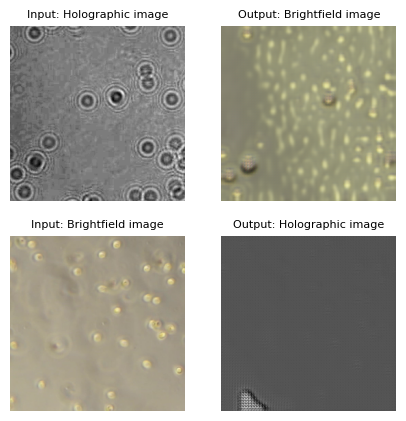



Epoch 31/100
----------
Batch 1/110 : Generator Loss: 2.7813, Discriminator Loss: 0.0397
Batch 21/110 : Generator Loss: 2.5261, Discriminator Loss: 0.3985
Batch 41/110 : Generator Loss: 2.6229, Discriminator Loss: 0.0652
Batch 61/110 : Generator Loss: 2.4857, Discriminator Loss: 0.0700
Batch 81/110 : Generator Loss: 2.5261, Discriminator Loss: 0.3533
Batch 101/110 : Generator Loss: 2.6999, Discriminator Loss: 0.2108
----------
Epoch 31/100 : Generator Loss: 2.5822, Discriminator Loss: 0.1876
Time taken: 0:00:35.117723


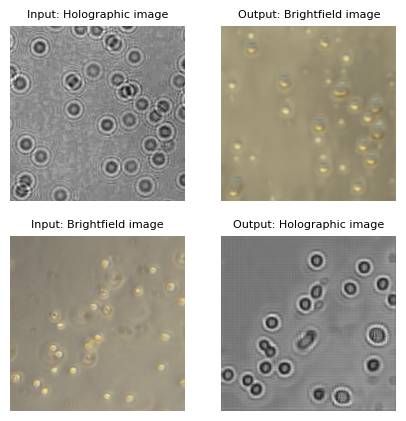



Epoch 32/100
----------
Batch 1/110 : Generator Loss: 2.5671, Discriminator Loss: 0.3046
Batch 21/110 : Generator Loss: 2.1562, Discriminator Loss: 0.2673
Batch 41/110 : Generator Loss: 2.4776, Discriminator Loss: 0.3237
Batch 61/110 : Generator Loss: 2.0749, Discriminator Loss: 0.2782
Batch 81/110 : Generator Loss: 2.2982, Discriminator Loss: 0.2253
Batch 101/110 : Generator Loss: 1.8715, Discriminator Loss: 0.2937
----------
Epoch 32/100 : Generator Loss: 2.3207, Discriminator Loss: 0.3274
Time taken: 0:00:35.139129


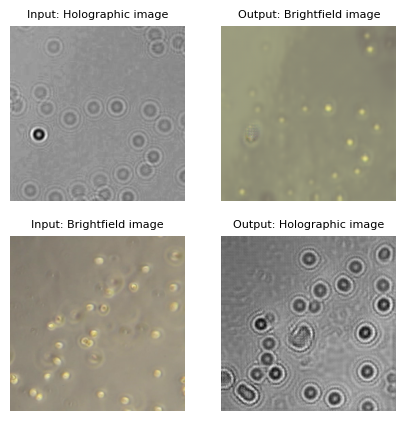



Epoch 33/100
----------
Batch 1/110 : Generator Loss: 2.1403, Discriminator Loss: 0.2493
Batch 21/110 : Generator Loss: 1.9371, Discriminator Loss: 0.3635
Batch 41/110 : Generator Loss: 2.1722, Discriminator Loss: 0.2892
Batch 61/110 : Generator Loss: 2.1841, Discriminator Loss: 0.2993
Batch 81/110 : Generator Loss: 2.2337, Discriminator Loss: 0.2522
Batch 101/110 : Generator Loss: 2.0845, Discriminator Loss: 0.3981
----------
Epoch 33/100 : Generator Loss: 2.1484, Discriminator Loss: 0.3161
Time taken: 0:00:35.088196


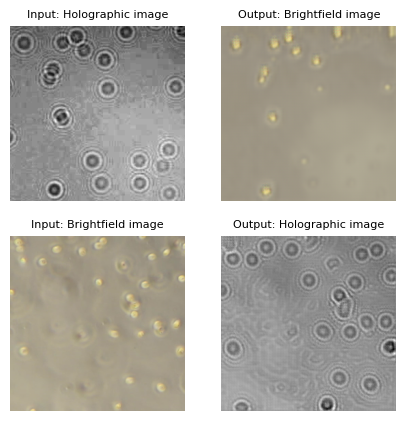



Epoch 34/100
----------
Batch 1/110 : Generator Loss: 1.8039, Discriminator Loss: 0.3665
Batch 21/110 : Generator Loss: 2.1331, Discriminator Loss: 0.2512
Batch 41/110 : Generator Loss: 2.2299, Discriminator Loss: 0.2055
Batch 61/110 : Generator Loss: 2.1319, Discriminator Loss: 0.4142
Batch 81/110 : Generator Loss: 1.9787, Discriminator Loss: 0.2573
Batch 101/110 : Generator Loss: 2.3271, Discriminator Loss: 0.2710
----------
Epoch 34/100 : Generator Loss: 2.1473, Discriminator Loss: 0.2887
Time taken: 0:00:35.031516


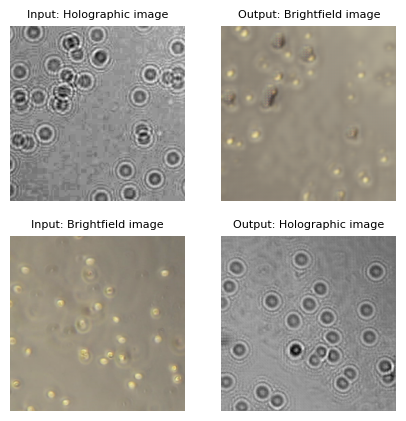



Epoch 35/100
----------
Batch 1/110 : Generator Loss: 2.2049, Discriminator Loss: 0.2951
Batch 21/110 : Generator Loss: 2.1530, Discriminator Loss: 0.2782
Batch 41/110 : Generator Loss: 2.1880, Discriminator Loss: 0.2748
Batch 61/110 : Generator Loss: 2.1778, Discriminator Loss: 0.3375
Batch 81/110 : Generator Loss: 2.0992, Discriminator Loss: 0.1992
Batch 101/110 : Generator Loss: 2.0803, Discriminator Loss: 0.2765
----------
Epoch 35/100 : Generator Loss: 2.1795, Discriminator Loss: 0.2805
Time taken: 0:00:35.104509


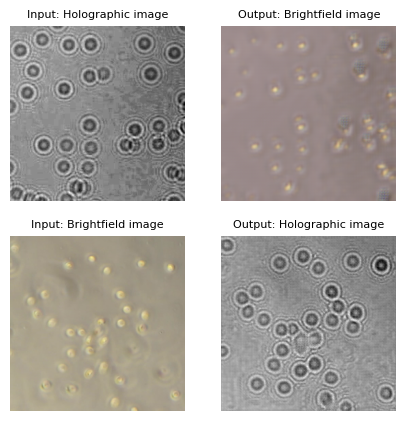



Epoch 36/100
----------
Batch 1/110 : Generator Loss: 2.1037, Discriminator Loss: 0.2490
Batch 21/110 : Generator Loss: 2.2194, Discriminator Loss: 0.2996
Batch 41/110 : Generator Loss: 2.3888, Discriminator Loss: 0.2320
Batch 61/110 : Generator Loss: 2.3173, Discriminator Loss: 0.2741
Batch 81/110 : Generator Loss: 2.2966, Discriminator Loss: 0.1840
Batch 101/110 : Generator Loss: 2.2122, Discriminator Loss: 0.2408
----------
Epoch 36/100 : Generator Loss: 2.2445, Discriminator Loss: 0.2508
Time taken: 0:00:35.082377


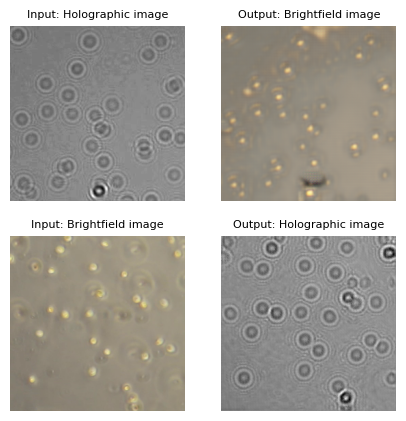



Epoch 37/100
----------
Batch 1/110 : Generator Loss: 2.0203, Discriminator Loss: 0.2646
Batch 21/110 : Generator Loss: 2.2670, Discriminator Loss: 0.2955
Batch 41/110 : Generator Loss: 2.2429, Discriminator Loss: 0.2386
Batch 61/110 : Generator Loss: 2.3616, Discriminator Loss: 0.2825
Batch 81/110 : Generator Loss: 2.2220, Discriminator Loss: 0.2856
Batch 101/110 : Generator Loss: 1.9256, Discriminator Loss: 0.2420
----------
Epoch 37/100 : Generator Loss: 2.2032, Discriminator Loss: 0.2770
Time taken: 0:00:35.101699


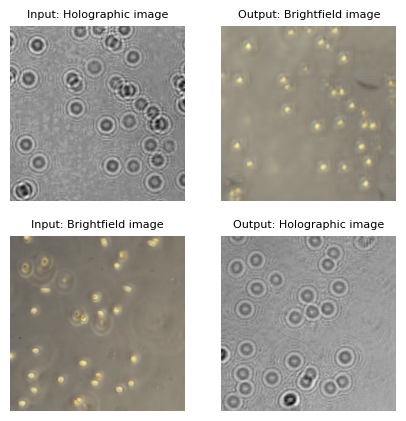



Epoch 38/100
----------
Batch 1/110 : Generator Loss: 2.2110, Discriminator Loss: 0.3736
Batch 21/110 : Generator Loss: 2.2897, Discriminator Loss: 0.2178
Batch 41/110 : Generator Loss: 2.1555, Discriminator Loss: 0.2401
Batch 61/110 : Generator Loss: 2.2246, Discriminator Loss: 0.2175
Batch 81/110 : Generator Loss: 2.0390, Discriminator Loss: 0.2946
Batch 101/110 : Generator Loss: 2.5123, Discriminator Loss: 0.3436
----------
Epoch 38/100 : Generator Loss: 2.2621, Discriminator Loss: 0.2372
Time taken: 0:00:34.968832


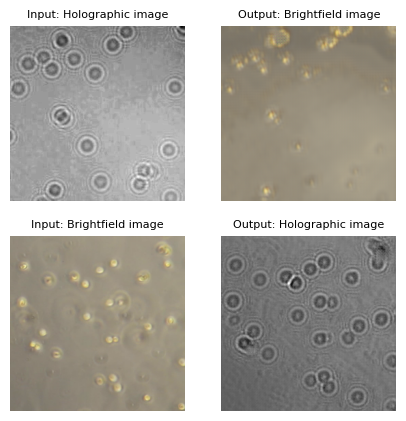



Epoch 39/100
----------
Batch 1/110 : Generator Loss: 2.4683, Discriminator Loss: 0.2730
Batch 21/110 : Generator Loss: 2.4698, Discriminator Loss: 0.2063
Batch 41/110 : Generator Loss: 2.3921, Discriminator Loss: 0.2270
Batch 61/110 : Generator Loss: 2.3019, Discriminator Loss: 0.1890
Batch 81/110 : Generator Loss: 2.1827, Discriminator Loss: 0.2386
Batch 101/110 : Generator Loss: 2.3028, Discriminator Loss: 0.2206
----------
Epoch 39/100 : Generator Loss: 2.2849, Discriminator Loss: 0.2214
Time taken: 0:00:35.112794


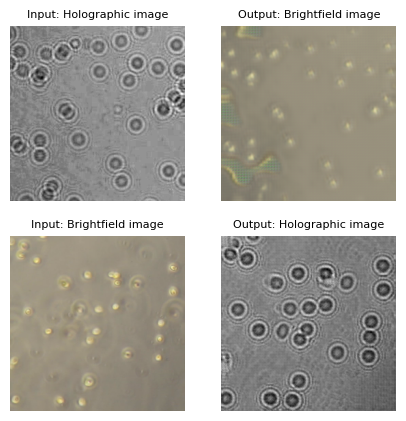



Epoch 40/100
----------
Batch 1/110 : Generator Loss: 2.1012, Discriminator Loss: 0.1626
Batch 21/110 : Generator Loss: 2.2814, Discriminator Loss: 0.2111
Batch 41/110 : Generator Loss: 2.3044, Discriminator Loss: 0.2121
Batch 61/110 : Generator Loss: 2.2225, Discriminator Loss: 0.2317
Batch 81/110 : Generator Loss: 2.1265, Discriminator Loss: 0.1641
Batch 101/110 : Generator Loss: 2.3415, Discriminator Loss: 0.1888
----------
Epoch 40/100 : Generator Loss: 2.2947, Discriminator Loss: 0.2090
Time taken: 0:00:35.101866


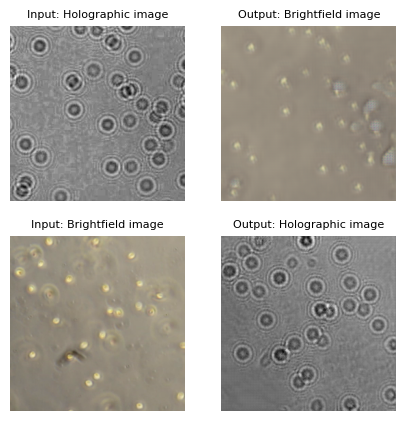



Epoch 41/100
----------
Batch 1/110 : Generator Loss: 2.1417, Discriminator Loss: 0.2299
Batch 21/110 : Generator Loss: 2.4508, Discriminator Loss: 0.2105
Batch 41/110 : Generator Loss: 1.9931, Discriminator Loss: 0.1410
Batch 61/110 : Generator Loss: 2.4705, Discriminator Loss: 0.1230
Batch 81/110 : Generator Loss: 2.2964, Discriminator Loss: 0.2249
Batch 101/110 : Generator Loss: 2.3218, Discriminator Loss: 0.1647
----------
Epoch 41/100 : Generator Loss: 2.3064, Discriminator Loss: 0.2083
Time taken: 0:00:35.114860


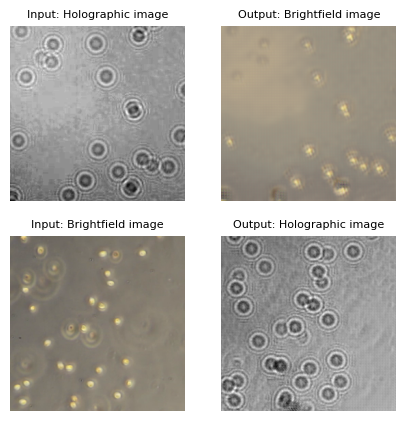



Epoch 42/100
----------
Batch 1/110 : Generator Loss: 2.1986, Discriminator Loss: 0.1581
Batch 21/110 : Generator Loss: 2.2029, Discriminator Loss: 0.1863
Batch 41/110 : Generator Loss: 2.1366, Discriminator Loss: 0.2369
Batch 61/110 : Generator Loss: 2.3853, Discriminator Loss: 0.1322
Batch 81/110 : Generator Loss: 2.6510, Discriminator Loss: 0.2686
Batch 101/110 : Generator Loss: 1.9543, Discriminator Loss: 0.1698
----------
Epoch 42/100 : Generator Loss: 2.3202, Discriminator Loss: 0.1722
Time taken: 0:00:35.107725


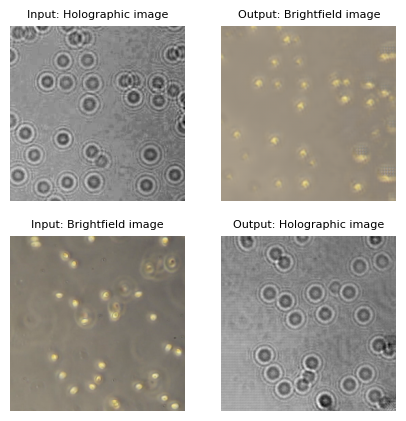



Epoch 43/100
----------
Batch 1/110 : Generator Loss: 2.4093, Discriminator Loss: 0.1726
Batch 21/110 : Generator Loss: 2.3885, Discriminator Loss: 0.1648
Batch 41/110 : Generator Loss: 2.2220, Discriminator Loss: 0.1573
Batch 61/110 : Generator Loss: 2.4869, Discriminator Loss: 0.1729
Batch 81/110 : Generator Loss: 2.4638, Discriminator Loss: 0.1636
Batch 101/110 : Generator Loss: 2.2764, Discriminator Loss: 0.1345
----------
Epoch 43/100 : Generator Loss: 2.3523, Discriminator Loss: 0.1827
Time taken: 0:00:35.088528


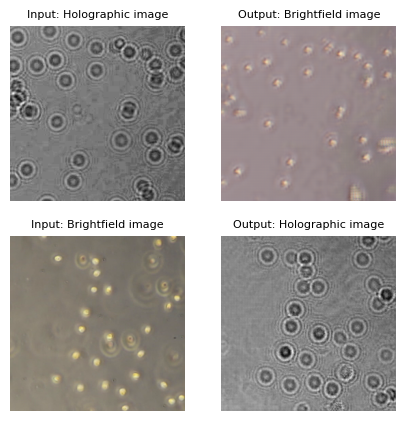



Epoch 44/100
----------
Batch 1/110 : Generator Loss: 2.2617, Discriminator Loss: 0.2179
Batch 21/110 : Generator Loss: 2.4360, Discriminator Loss: 0.1244
Batch 41/110 : Generator Loss: 2.4562, Discriminator Loss: 0.1359
Batch 61/110 : Generator Loss: 2.3014, Discriminator Loss: 0.1307
Batch 81/110 : Generator Loss: 2.5959, Discriminator Loss: 0.0911
Batch 101/110 : Generator Loss: 2.5152, Discriminator Loss: 0.2936
----------
Epoch 44/100 : Generator Loss: 2.4234, Discriminator Loss: 0.1343
Time taken: 0:00:35.082003


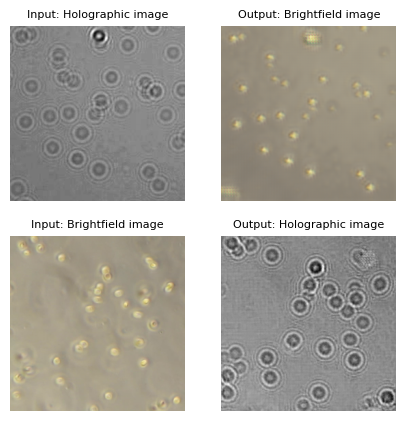



Epoch 45/100
----------
Batch 1/110 : Generator Loss: 2.3654, Discriminator Loss: 0.2302
Batch 21/110 : Generator Loss: 2.4402, Discriminator Loss: 0.1375
Batch 41/110 : Generator Loss: 2.4450, Discriminator Loss: 0.1190
Batch 61/110 : Generator Loss: 2.5792, Discriminator Loss: 0.1523
Batch 81/110 : Generator Loss: 2.3710, Discriminator Loss: 0.0998
Batch 101/110 : Generator Loss: 2.7424, Discriminator Loss: 0.1215
----------
Epoch 45/100 : Generator Loss: 2.4380, Discriminator Loss: 0.1434
Time taken: 0:00:35.168739


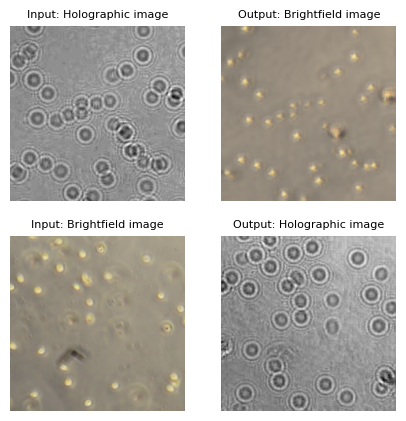



Epoch 46/100
----------
Batch 1/110 : Generator Loss: 2.5575, Discriminator Loss: 0.1314
Batch 21/110 : Generator Loss: 2.8178, Discriminator Loss: 0.2907
Batch 41/110 : Generator Loss: 2.5739, Discriminator Loss: 0.1484
Batch 61/110 : Generator Loss: 2.4891, Discriminator Loss: 0.2004
Batch 81/110 : Generator Loss: 2.4348, Discriminator Loss: 0.2140
Batch 101/110 : Generator Loss: 2.2848, Discriminator Loss: 0.2428
----------
Epoch 46/100 : Generator Loss: 2.4129, Discriminator Loss: 0.1881
Time taken: 0:00:35.140657


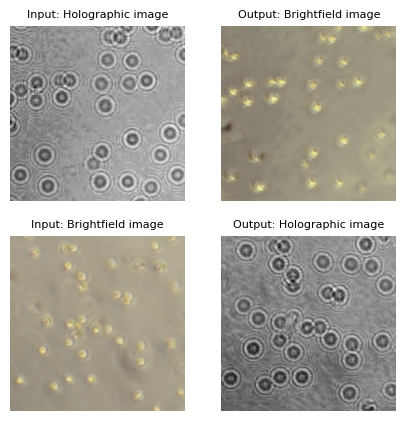



Epoch 47/100
----------
Batch 1/110 : Generator Loss: 2.5116, Discriminator Loss: 0.1677
Batch 21/110 : Generator Loss: 2.4459, Discriminator Loss: 0.1282
Batch 41/110 : Generator Loss: 2.3426, Discriminator Loss: 0.1785
Batch 61/110 : Generator Loss: 2.5928, Discriminator Loss: 0.1777
Batch 81/110 : Generator Loss: 2.4753, Discriminator Loss: 0.1155
Batch 101/110 : Generator Loss: 2.3611, Discriminator Loss: 0.1286
----------
Epoch 47/100 : Generator Loss: 2.4042, Discriminator Loss: 0.2040
Time taken: 0:00:35.155245


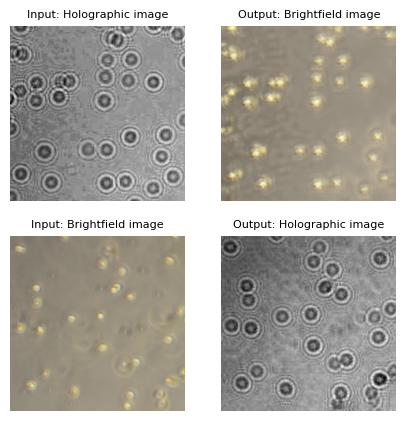



Epoch 48/100
----------
Batch 1/110 : Generator Loss: 2.5549, Discriminator Loss: 0.2858
Batch 21/110 : Generator Loss: 2.2527, Discriminator Loss: 0.3494
Batch 41/110 : Generator Loss: 2.6368, Discriminator Loss: 0.1037
Batch 61/110 : Generator Loss: 2.3717, Discriminator Loss: 0.1181
Batch 81/110 : Generator Loss: 2.0461, Discriminator Loss: 0.2073
Batch 101/110 : Generator Loss: 2.2998, Discriminator Loss: 0.1416
----------
Epoch 48/100 : Generator Loss: 2.4083, Discriminator Loss: 0.1757
Time taken: 0:00:35.184480


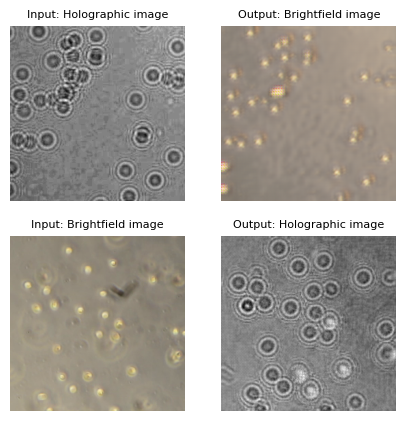



Epoch 49/100
----------
Batch 1/110 : Generator Loss: 2.6672, Discriminator Loss: 0.1661
Batch 21/110 : Generator Loss: 2.3813, Discriminator Loss: 0.1863
Batch 41/110 : Generator Loss: 2.1671, Discriminator Loss: 0.1644
Batch 61/110 : Generator Loss: 2.5380, Discriminator Loss: 0.1423
Batch 81/110 : Generator Loss: 2.5836, Discriminator Loss: 0.1496
Batch 101/110 : Generator Loss: 2.3081, Discriminator Loss: 0.2302
----------
Epoch 49/100 : Generator Loss: 2.4158, Discriminator Loss: 0.1671
Time taken: 0:00:35.121818


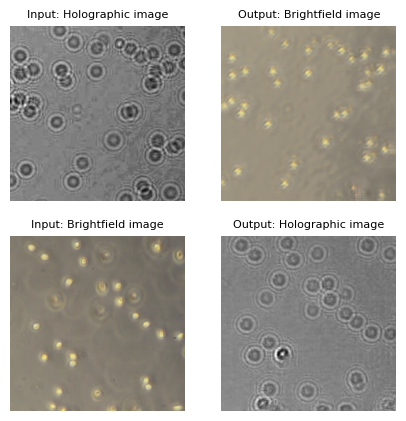



Epoch 50/100
----------
Batch 1/110 : Generator Loss: 2.4523, Discriminator Loss: 0.2663
Batch 21/110 : Generator Loss: 2.6617, Discriminator Loss: 0.0855
Batch 41/110 : Generator Loss: 2.4237, Discriminator Loss: 0.2283
Batch 61/110 : Generator Loss: 2.5376, Discriminator Loss: 0.1227
Batch 81/110 : Generator Loss: 2.4482, Discriminator Loss: 0.1595
Batch 101/110 : Generator Loss: 2.4586, Discriminator Loss: 0.5894
----------
Epoch 50/100 : Generator Loss: 2.4165, Discriminator Loss: 0.1865
Time taken: 0:00:35.126620


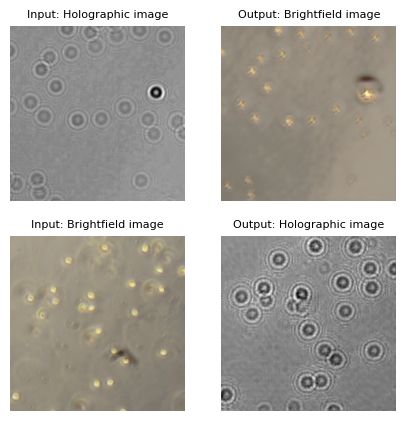



Epoch 51/100
----------
Batch 1/110 : Generator Loss: 2.4854, Discriminator Loss: 0.3115
Batch 21/110 : Generator Loss: 2.2026, Discriminator Loss: 0.2635
Batch 41/110 : Generator Loss: 2.4025, Discriminator Loss: 0.2272
Batch 61/110 : Generator Loss: 2.3769, Discriminator Loss: 0.2114
Batch 81/110 : Generator Loss: 2.5280, Discriminator Loss: 0.2189
Batch 101/110 : Generator Loss: 2.1384, Discriminator Loss: 0.1517
----------
Epoch 51/100 : Generator Loss: 2.3850, Discriminator Loss: 0.2230
Time taken: 0:00:35.175928


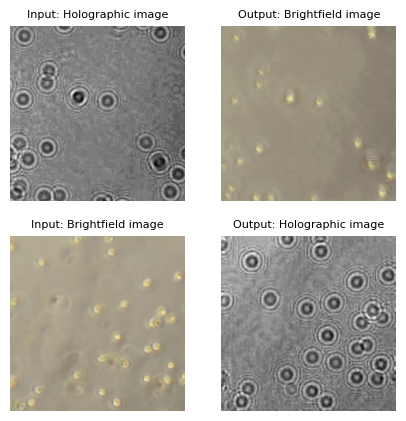



Epoch 52/100
----------
Batch 1/110 : Generator Loss: 2.2852, Discriminator Loss: 0.2340
Batch 21/110 : Generator Loss: 2.6882, Discriminator Loss: 0.2682
Batch 41/110 : Generator Loss: 2.4789, Discriminator Loss: 0.1813
Batch 61/110 : Generator Loss: 2.2551, Discriminator Loss: 0.3180
Batch 81/110 : Generator Loss: 2.4872, Discriminator Loss: 0.1884
Batch 101/110 : Generator Loss: 2.3964, Discriminator Loss: 0.1293
----------
Epoch 52/100 : Generator Loss: 2.3583, Discriminator Loss: 0.2195
Time taken: 0:00:35.135447


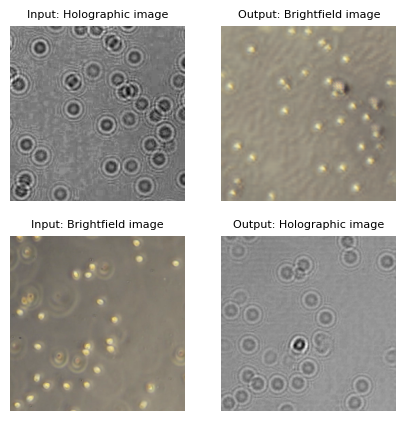



Epoch 53/100
----------
Batch 1/110 : Generator Loss: 2.2468, Discriminator Loss: 0.2071
Batch 21/110 : Generator Loss: 2.4197, Discriminator Loss: 0.2443
Batch 41/110 : Generator Loss: 2.5191, Discriminator Loss: 0.2584
Batch 61/110 : Generator Loss: 2.1599, Discriminator Loss: 0.3162
Batch 81/110 : Generator Loss: 2.2102, Discriminator Loss: 0.1544
Batch 101/110 : Generator Loss: 2.2335, Discriminator Loss: 0.3603
----------
Epoch 53/100 : Generator Loss: 2.3210, Discriminator Loss: 0.2316
Time taken: 0:00:35.188251


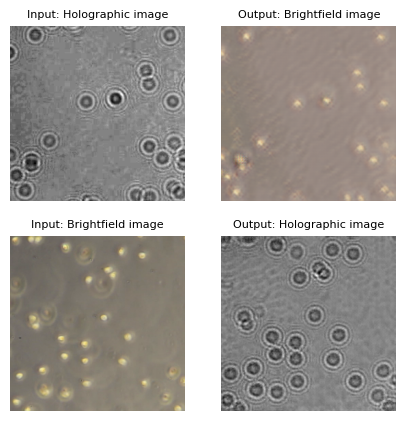



Epoch 54/100
----------
Batch 1/110 : Generator Loss: 2.1416, Discriminator Loss: 0.2454
Batch 21/110 : Generator Loss: 1.9611, Discriminator Loss: 0.1820
Batch 41/110 : Generator Loss: 2.3819, Discriminator Loss: 0.1865
Batch 61/110 : Generator Loss: 2.5175, Discriminator Loss: 0.2397
Batch 81/110 : Generator Loss: 2.3646, Discriminator Loss: 0.1900
Batch 101/110 : Generator Loss: 2.2261, Discriminator Loss: 0.2125
----------
Epoch 54/100 : Generator Loss: 2.2957, Discriminator Loss: 0.2221
Time taken: 0:00:35.080998


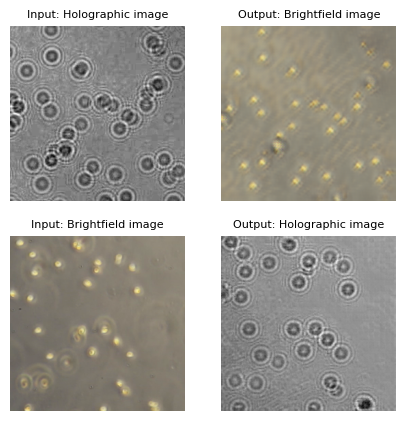



Epoch 55/100
----------
Batch 1/110 : Generator Loss: 2.3262, Discriminator Loss: 0.2797
Batch 21/110 : Generator Loss: 2.3353, Discriminator Loss: 0.1368
Batch 41/110 : Generator Loss: 2.2892, Discriminator Loss: 0.1944
Batch 61/110 : Generator Loss: 2.4022, Discriminator Loss: 0.2065
Batch 81/110 : Generator Loss: 2.3156, Discriminator Loss: 0.1829
Batch 101/110 : Generator Loss: 2.2076, Discriminator Loss: 0.1503
----------
Epoch 55/100 : Generator Loss: 2.2718, Discriminator Loss: 0.2177
Time taken: 0:00:35.124027


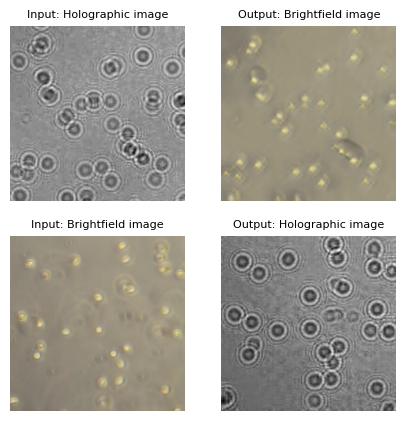



Epoch 56/100
----------
Batch 1/110 : Generator Loss: 2.0599, Discriminator Loss: 0.2676
Batch 21/110 : Generator Loss: 2.3726, Discriminator Loss: 0.3119
Batch 41/110 : Generator Loss: 2.3623, Discriminator Loss: 0.1612
Batch 61/110 : Generator Loss: 2.3778, Discriminator Loss: 0.2632
Batch 81/110 : Generator Loss: 2.3856, Discriminator Loss: 0.3878
Batch 101/110 : Generator Loss: 2.2987, Discriminator Loss: 0.1792
----------
Epoch 56/100 : Generator Loss: 2.3010, Discriminator Loss: 0.2264
Time taken: 0:00:35.139957


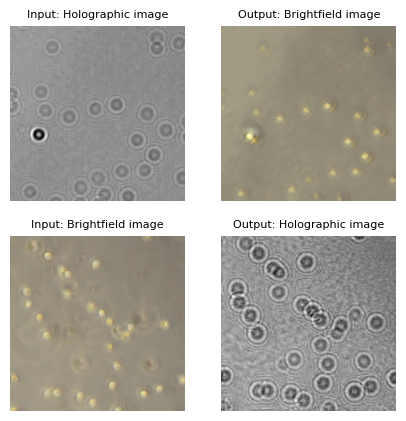



Epoch 57/100
----------
Batch 1/110 : Generator Loss: 2.1624, Discriminator Loss: 0.2112
Batch 21/110 : Generator Loss: 2.3772, Discriminator Loss: 0.1114
Batch 41/110 : Generator Loss: 2.1592, Discriminator Loss: 0.1733
Batch 61/110 : Generator Loss: 2.4349, Discriminator Loss: 0.2581
Batch 81/110 : Generator Loss: 2.0591, Discriminator Loss: 0.2063
Batch 101/110 : Generator Loss: 2.4624, Discriminator Loss: 0.2386
----------
Epoch 57/100 : Generator Loss: 2.2973, Discriminator Loss: 0.2218
Time taken: 0:00:35.129931


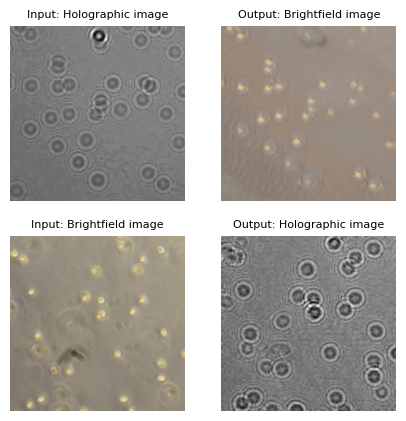



Epoch 58/100
----------
Batch 1/110 : Generator Loss: 2.4343, Discriminator Loss: 0.2637
Batch 21/110 : Generator Loss: 2.3827, Discriminator Loss: 0.1246
Batch 41/110 : Generator Loss: 2.2240, Discriminator Loss: 0.1622
Batch 61/110 : Generator Loss: 2.5853, Discriminator Loss: 0.3705
Batch 81/110 : Generator Loss: 2.3442, Discriminator Loss: 0.1784
Batch 101/110 : Generator Loss: 2.2508, Discriminator Loss: 0.2002
----------
Epoch 58/100 : Generator Loss: 2.3340, Discriminator Loss: 0.1899
Time taken: 0:00:35.171381


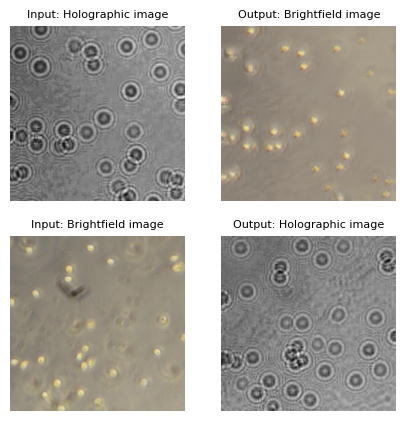



Epoch 59/100
----------
Batch 1/110 : Generator Loss: 2.2680, Discriminator Loss: 0.1862
Batch 21/110 : Generator Loss: 2.3223, Discriminator Loss: 0.1581
Batch 41/110 : Generator Loss: 2.2042, Discriminator Loss: 0.1121
Batch 61/110 : Generator Loss: 2.1293, Discriminator Loss: 0.1849
Batch 81/110 : Generator Loss: 2.2556, Discriminator Loss: 0.2055
Batch 101/110 : Generator Loss: 2.5392, Discriminator Loss: 0.3060
----------
Epoch 59/100 : Generator Loss: 2.2745, Discriminator Loss: 0.2185
Time taken: 0:00:34.993269


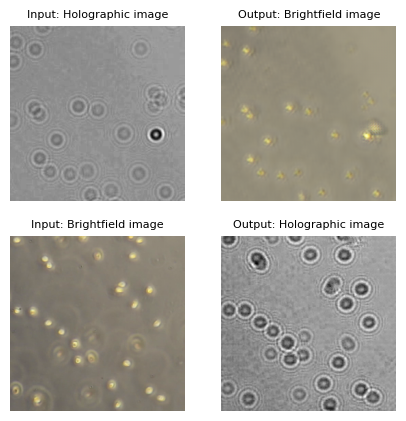



Epoch 60/100
----------
Batch 1/110 : Generator Loss: 2.3376, Discriminator Loss: 0.1564
Batch 21/110 : Generator Loss: 2.2588, Discriminator Loss: 0.2168
Batch 41/110 : Generator Loss: 2.3602, Discriminator Loss: 0.2129
Batch 61/110 : Generator Loss: 2.3670, Discriminator Loss: 0.1342
Batch 81/110 : Generator Loss: 2.2877, Discriminator Loss: 0.2547
Batch 101/110 : Generator Loss: 2.3175, Discriminator Loss: 0.3140
----------
Epoch 60/100 : Generator Loss: 2.2597, Discriminator Loss: 0.1986
Time taken: 0:00:35.111073


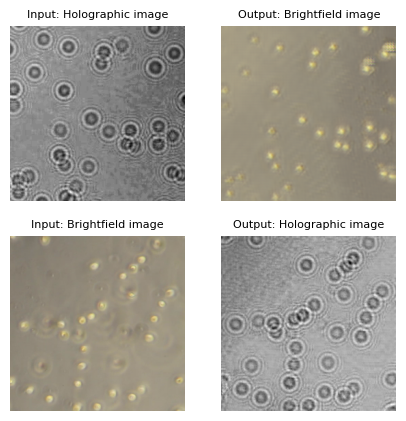



Epoch 61/100
----------
Batch 1/110 : Generator Loss: 2.2212, Discriminator Loss: 0.2573
Batch 21/110 : Generator Loss: 2.1553, Discriminator Loss: 0.1799
Batch 41/110 : Generator Loss: 2.2497, Discriminator Loss: 0.1223
Batch 61/110 : Generator Loss: 1.9628, Discriminator Loss: 0.4177
Batch 81/110 : Generator Loss: 2.1854, Discriminator Loss: 0.4389
Batch 101/110 : Generator Loss: 2.2880, Discriminator Loss: 0.2241
----------
Epoch 61/100 : Generator Loss: 2.1938, Discriminator Loss: 0.2501
Time taken: 0:00:35.113688


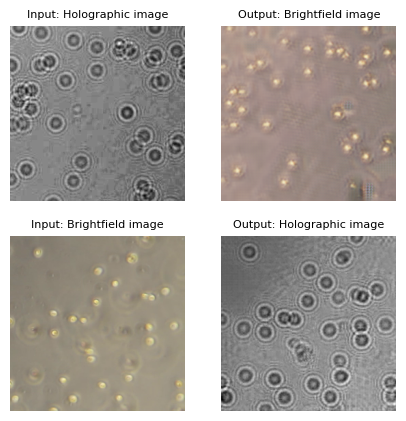



Epoch 62/100
----------
Batch 1/110 : Generator Loss: 2.4512, Discriminator Loss: 0.1248
Batch 21/110 : Generator Loss: 2.3322, Discriminator Loss: 0.2101
Batch 41/110 : Generator Loss: 2.2278, Discriminator Loss: 0.1524
Batch 61/110 : Generator Loss: 2.3877, Discriminator Loss: 0.2318
Batch 81/110 : Generator Loss: 2.2322, Discriminator Loss: 0.1920
Batch 101/110 : Generator Loss: 2.4189, Discriminator Loss: 0.1791
----------
Epoch 62/100 : Generator Loss: 2.2982, Discriminator Loss: 0.2008
Time taken: 0:00:35.156425


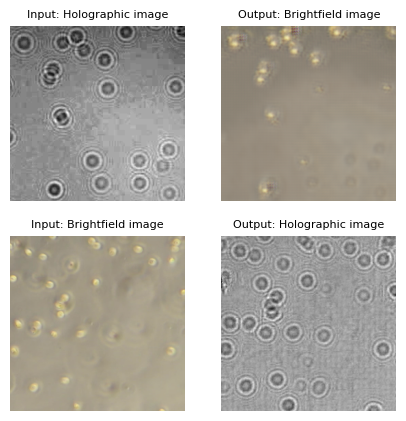



Epoch 63/100
----------
Batch 1/110 : Generator Loss: 2.4320, Discriminator Loss: 0.2114
Batch 21/110 : Generator Loss: 2.2155, Discriminator Loss: 0.1456
Batch 41/110 : Generator Loss: 2.3899, Discriminator Loss: 0.2505
Batch 61/110 : Generator Loss: 2.1977, Discriminator Loss: 0.3042
Batch 81/110 : Generator Loss: 2.1001, Discriminator Loss: 0.1264
Batch 101/110 : Generator Loss: 2.1390, Discriminator Loss: 0.2031
----------
Epoch 63/100 : Generator Loss: 2.2454, Discriminator Loss: 0.2021
Time taken: 0:00:35.180151


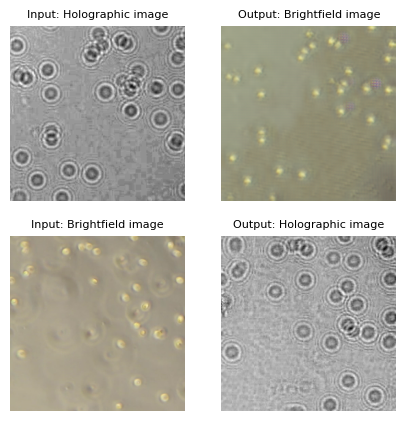



Epoch 64/100
----------
Batch 1/110 : Generator Loss: 2.2321, Discriminator Loss: 0.2202
Batch 21/110 : Generator Loss: 2.3526, Discriminator Loss: 0.1882
Batch 41/110 : Generator Loss: 2.1702, Discriminator Loss: 0.2768
Batch 61/110 : Generator Loss: 1.9767, Discriminator Loss: 0.2303
Batch 81/110 : Generator Loss: 2.4115, Discriminator Loss: 0.1968
Batch 101/110 : Generator Loss: 2.1241, Discriminator Loss: 0.2071
----------
Epoch 64/100 : Generator Loss: 2.2447, Discriminator Loss: 0.2080
Time taken: 0:00:35.272238


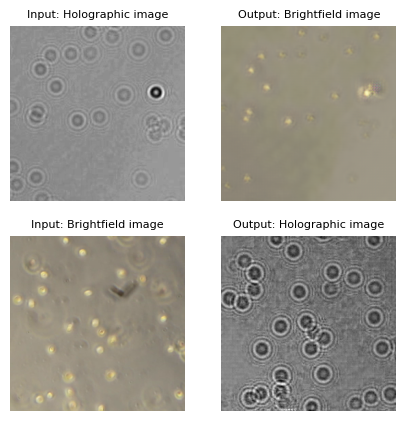



Epoch 65/100
----------
Batch 1/110 : Generator Loss: 2.4465, Discriminator Loss: 0.1130
Batch 21/110 : Generator Loss: 2.1749, Discriminator Loss: 0.2331
Batch 41/110 : Generator Loss: 2.1678, Discriminator Loss: 0.2221
Batch 61/110 : Generator Loss: 2.4273, Discriminator Loss: 0.1587
Batch 81/110 : Generator Loss: 2.1613, Discriminator Loss: 0.1456
Batch 101/110 : Generator Loss: 2.2853, Discriminator Loss: 0.2112
----------
Epoch 65/100 : Generator Loss: 2.2528, Discriminator Loss: 0.1912
Time taken: 0:00:35.252089


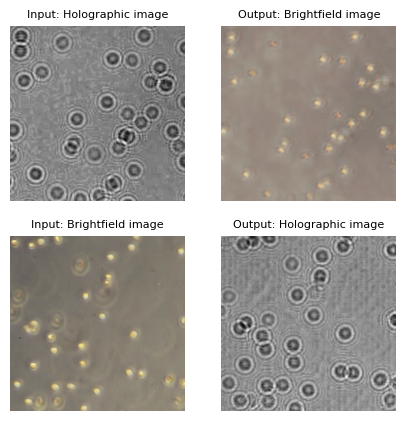



Epoch 66/100
----------
Batch 1/110 : Generator Loss: 2.3853, Discriminator Loss: 0.1755
Batch 21/110 : Generator Loss: 2.0604, Discriminator Loss: 0.1656
Batch 41/110 : Generator Loss: 2.2633, Discriminator Loss: 0.2008
Batch 61/110 : Generator Loss: 2.1436, Discriminator Loss: 0.2138
Batch 81/110 : Generator Loss: 2.3680, Discriminator Loss: 0.2217
Batch 101/110 : Generator Loss: 2.0237, Discriminator Loss: 0.2658
----------
Epoch 66/100 : Generator Loss: 2.1944, Discriminator Loss: 0.2334
Time taken: 0:00:35.156648


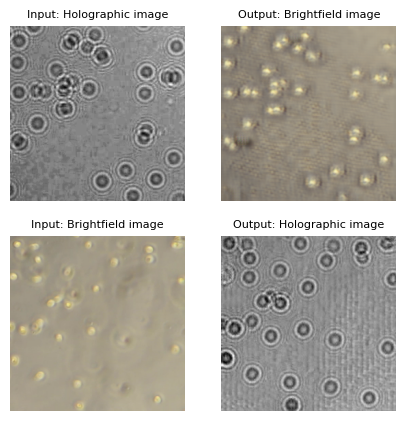



Epoch 67/100
----------
Batch 1/110 : Generator Loss: 2.2492, Discriminator Loss: 0.2125
Batch 21/110 : Generator Loss: 2.1886, Discriminator Loss: 0.1998
Batch 41/110 : Generator Loss: 2.0527, Discriminator Loss: 0.2068
Batch 61/110 : Generator Loss: 2.2448, Discriminator Loss: 0.1927
Batch 81/110 : Generator Loss: 2.3452, Discriminator Loss: 0.2070
Batch 101/110 : Generator Loss: 2.2243, Discriminator Loss: 0.1853
----------
Epoch 67/100 : Generator Loss: 2.2499, Discriminator Loss: 0.1966
Time taken: 0:00:35.101036


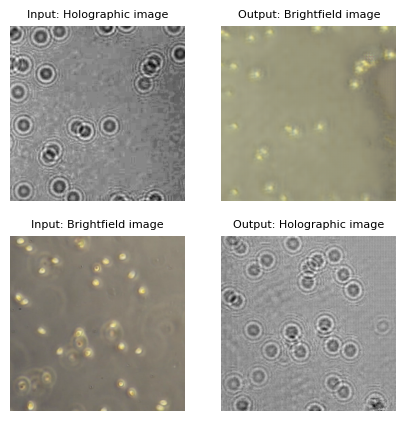



Epoch 68/100
----------
Batch 1/110 : Generator Loss: 2.3074, Discriminator Loss: 0.2028
Batch 21/110 : Generator Loss: 2.2377, Discriminator Loss: 0.1446
Batch 41/110 : Generator Loss: 2.1968, Discriminator Loss: 0.1605
Batch 61/110 : Generator Loss: 2.4023, Discriminator Loss: 0.1231
Batch 81/110 : Generator Loss: 2.5569, Discriminator Loss: 0.5605
Batch 101/110 : Generator Loss: 2.1561, Discriminator Loss: 0.1953
----------
Epoch 68/100 : Generator Loss: 2.2116, Discriminator Loss: 0.2057
Time taken: 0:00:35.089582


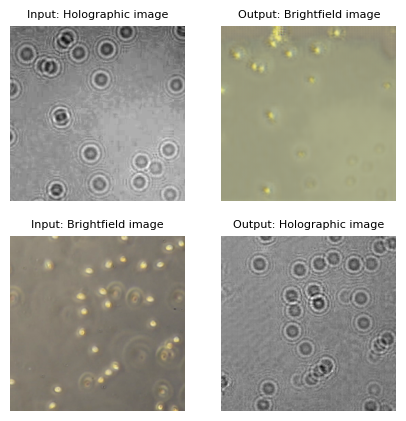



Epoch 69/100
----------
Batch 1/110 : Generator Loss: 2.0674, Discriminator Loss: 0.2082
Batch 21/110 : Generator Loss: 2.3942, Discriminator Loss: 0.2360
Batch 41/110 : Generator Loss: 2.0456, Discriminator Loss: 0.2470
Batch 61/110 : Generator Loss: 2.0951, Discriminator Loss: 0.0856
Batch 81/110 : Generator Loss: 2.2687, Discriminator Loss: 0.2125
Batch 101/110 : Generator Loss: 1.9367, Discriminator Loss: 0.2565
----------
Epoch 69/100 : Generator Loss: 2.1522, Discriminator Loss: 0.1989
Time taken: 0:00:35.100919


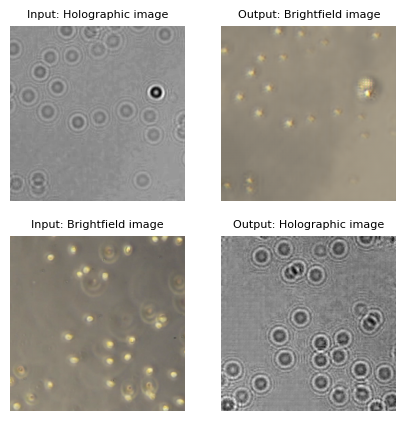



Epoch 70/100
----------
Batch 1/110 : Generator Loss: 1.9935, Discriminator Loss: 0.2520
Batch 21/110 : Generator Loss: 2.0861, Discriminator Loss: 0.1553
Batch 41/110 : Generator Loss: 2.1560, Discriminator Loss: 0.1401
Batch 61/110 : Generator Loss: 2.0558, Discriminator Loss: 0.2133
Batch 81/110 : Generator Loss: 2.6203, Discriminator Loss: 0.1187
Batch 101/110 : Generator Loss: 2.2651, Discriminator Loss: 0.1305
----------
Epoch 70/100 : Generator Loss: 2.2020, Discriminator Loss: 0.1772
Time taken: 0:00:35.101596


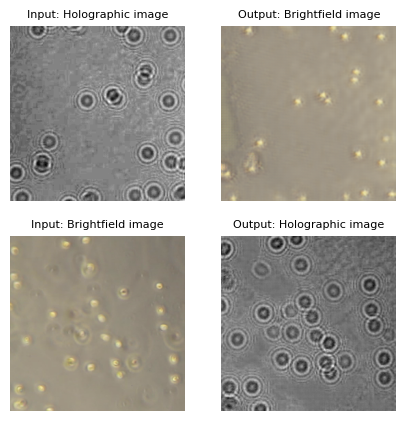



Epoch 71/100
----------
Batch 1/110 : Generator Loss: 1.9161, Discriminator Loss: 0.5022
Batch 21/110 : Generator Loss: 2.1057, Discriminator Loss: 0.1608
Batch 41/110 : Generator Loss: 2.0936, Discriminator Loss: 0.3096
Batch 61/110 : Generator Loss: 2.1040, Discriminator Loss: 0.1465
Batch 81/110 : Generator Loss: 2.1807, Discriminator Loss: 0.3296
Batch 101/110 : Generator Loss: 2.1178, Discriminator Loss: 0.2513
----------
Epoch 71/100 : Generator Loss: 2.2016, Discriminator Loss: 0.1867
Time taken: 0:00:35.184205


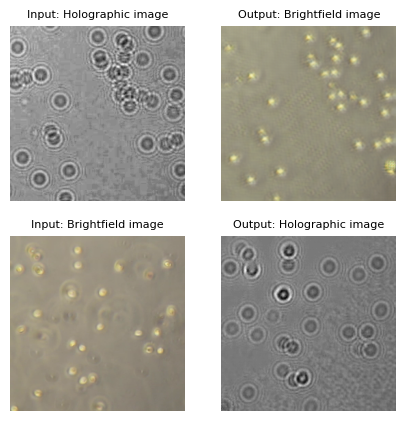



Epoch 72/100
----------
Batch 1/110 : Generator Loss: 2.1974, Discriminator Loss: 0.1223
Batch 21/110 : Generator Loss: 2.3694, Discriminator Loss: 0.1530
Batch 41/110 : Generator Loss: 2.1762, Discriminator Loss: 0.2663
Batch 61/110 : Generator Loss: 2.7069, Discriminator Loss: 0.1622
Batch 81/110 : Generator Loss: 2.2537, Discriminator Loss: 0.1066
Batch 101/110 : Generator Loss: 2.2689, Discriminator Loss: 0.1527
----------
Epoch 72/100 : Generator Loss: 2.2610, Discriminator Loss: 0.1758
Time taken: 0:00:35.111789


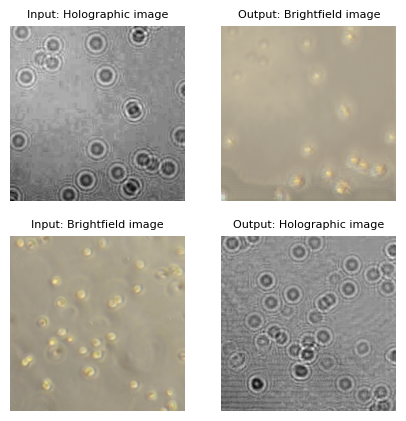



Epoch 73/100
----------
Batch 1/110 : Generator Loss: 2.2875, Discriminator Loss: 0.3686
Batch 21/110 : Generator Loss: 2.3871, Discriminator Loss: 0.1475
Batch 41/110 : Generator Loss: 2.1578, Discriminator Loss: 0.1173
Batch 61/110 : Generator Loss: 2.1944, Discriminator Loss: 0.2132
Batch 81/110 : Generator Loss: 2.0309, Discriminator Loss: 0.1981
Batch 101/110 : Generator Loss: 2.1530, Discriminator Loss: 0.3093
----------
Epoch 73/100 : Generator Loss: 2.2188, Discriminator Loss: 0.1771
Time taken: 0:00:35.112840


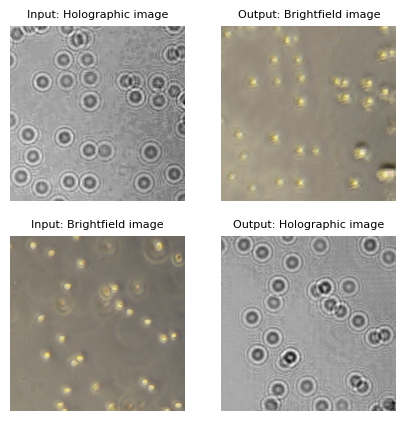



Epoch 74/100
----------
Batch 1/110 : Generator Loss: 2.0992, Discriminator Loss: 0.2348
Batch 21/110 : Generator Loss: 2.2178, Discriminator Loss: 0.1746
Batch 41/110 : Generator Loss: 2.2804, Discriminator Loss: 0.1484
Batch 61/110 : Generator Loss: 2.1290, Discriminator Loss: 0.3051
Batch 81/110 : Generator Loss: 2.1679, Discriminator Loss: 0.2194
Batch 101/110 : Generator Loss: 2.0116, Discriminator Loss: 0.1691
----------
Epoch 74/100 : Generator Loss: 2.2068, Discriminator Loss: 0.1707
Time taken: 0:00:35.098607


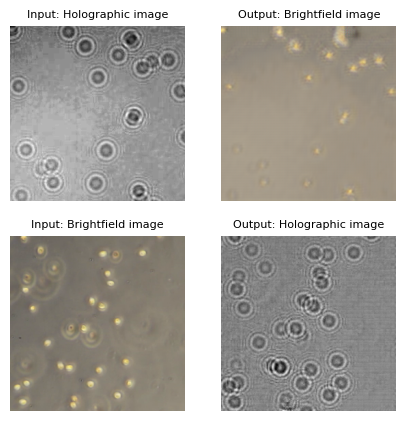



Epoch 75/100
----------
Batch 1/110 : Generator Loss: 2.2043, Discriminator Loss: 0.1445
Batch 21/110 : Generator Loss: 2.4117, Discriminator Loss: 0.1896
Batch 41/110 : Generator Loss: 2.6370, Discriminator Loss: 0.2764
Batch 61/110 : Generator Loss: 1.9540, Discriminator Loss: 0.1591
Batch 81/110 : Generator Loss: 2.0877, Discriminator Loss: 0.2052
Batch 101/110 : Generator Loss: 2.1285, Discriminator Loss: 0.1479
----------
Epoch 75/100 : Generator Loss: 2.1918, Discriminator Loss: 0.1852
Time taken: 0:00:35.215561


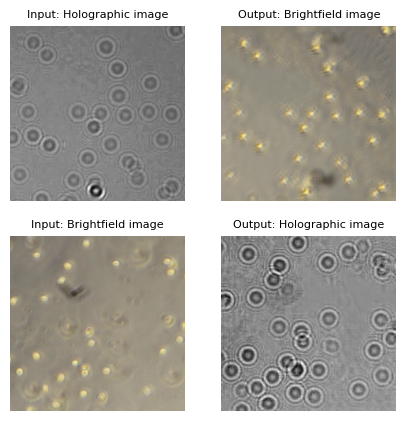



Epoch 76/100
----------
Batch 1/110 : Generator Loss: 2.2536, Discriminator Loss: 0.1022
Batch 21/110 : Generator Loss: 2.5375, Discriminator Loss: 0.1840
Batch 41/110 : Generator Loss: 2.1512, Discriminator Loss: 0.1798
Batch 61/110 : Generator Loss: 2.2379, Discriminator Loss: 0.1955
Batch 81/110 : Generator Loss: 2.3113, Discriminator Loss: 0.2222
Batch 101/110 : Generator Loss: 2.2439, Discriminator Loss: 0.1918
----------
Epoch 76/100 : Generator Loss: 2.2080, Discriminator Loss: 0.1813
Time taken: 0:00:35.155188


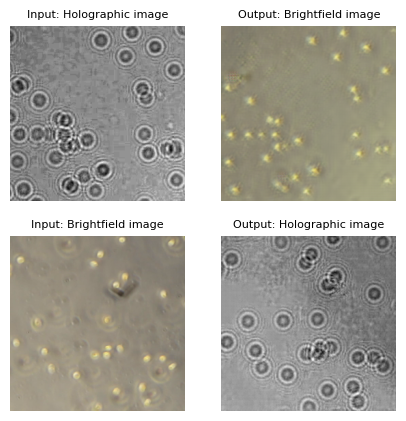



Epoch 77/100
----------
Batch 1/110 : Generator Loss: 2.1730, Discriminator Loss: 0.1458
Batch 21/110 : Generator Loss: 2.5724, Discriminator Loss: 0.2146
Batch 41/110 : Generator Loss: 2.1860, Discriminator Loss: 0.1421
Batch 61/110 : Generator Loss: 2.1339, Discriminator Loss: 0.1741
Batch 81/110 : Generator Loss: 2.3686, Discriminator Loss: 0.1378
Batch 101/110 : Generator Loss: 2.4103, Discriminator Loss: 0.1129
----------
Epoch 77/100 : Generator Loss: 2.2388, Discriminator Loss: 0.1573
Time taken: 0:00:35.145657


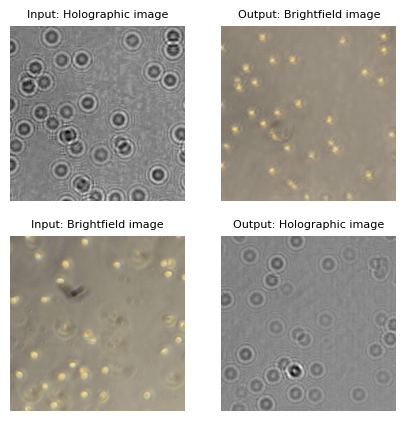



Epoch 78/100
----------
Batch 1/110 : Generator Loss: 2.2145, Discriminator Loss: 0.2037
Batch 21/110 : Generator Loss: 2.0583, Discriminator Loss: 0.2104
Batch 41/110 : Generator Loss: 2.1503, Discriminator Loss: 0.2146
Batch 61/110 : Generator Loss: 2.1556, Discriminator Loss: 0.1350
Batch 81/110 : Generator Loss: 2.3953, Discriminator Loss: 0.1963
Batch 101/110 : Generator Loss: 2.2242, Discriminator Loss: 0.1277
----------
Epoch 78/100 : Generator Loss: 2.2069, Discriminator Loss: 0.1949
Time taken: 0:00:35.105509


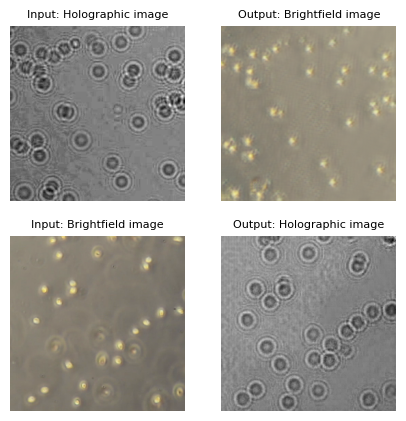



Epoch 79/100
----------
Batch 1/110 : Generator Loss: 2.0969, Discriminator Loss: 0.2543
Batch 21/110 : Generator Loss: 2.5648, Discriminator Loss: 0.1203
Batch 41/110 : Generator Loss: 2.3398, Discriminator Loss: 0.1417
Batch 61/110 : Generator Loss: 2.2835, Discriminator Loss: 0.0858
Batch 81/110 : Generator Loss: 2.2167, Discriminator Loss: 0.1476
Batch 101/110 : Generator Loss: 2.2523, Discriminator Loss: 0.2139
----------
Epoch 79/100 : Generator Loss: 2.3337, Discriminator Loss: 0.1332
Time taken: 0:00:35.156177


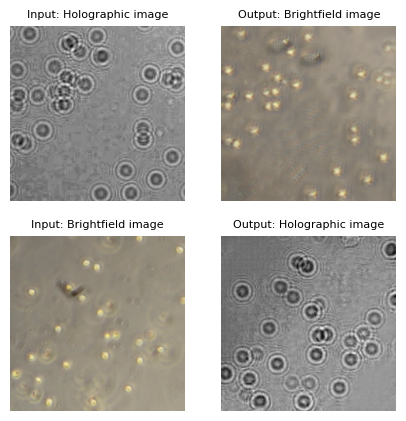



Epoch 80/100
----------
Batch 1/110 : Generator Loss: 2.0632, Discriminator Loss: 0.1658
Batch 21/110 : Generator Loss: 2.1968, Discriminator Loss: 0.1630
Batch 41/110 : Generator Loss: 2.0217, Discriminator Loss: 0.1898
Batch 61/110 : Generator Loss: 2.4806, Discriminator Loss: 0.1972
Batch 81/110 : Generator Loss: 2.1631, Discriminator Loss: 0.2317
Batch 101/110 : Generator Loss: 2.1683, Discriminator Loss: 0.1053
----------
Epoch 80/100 : Generator Loss: 2.2310, Discriminator Loss: 0.1794
Time taken: 0:00:35.104927


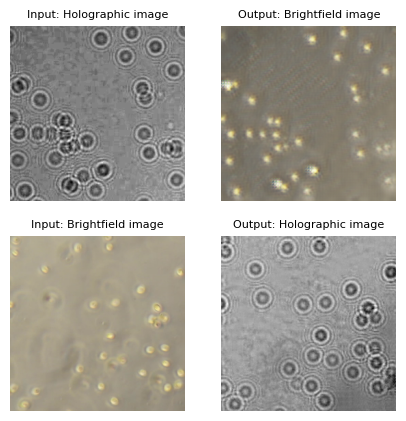



Epoch 81/100
----------
Batch 1/110 : Generator Loss: 2.0223, Discriminator Loss: 0.1578
Batch 21/110 : Generator Loss: 1.9711, Discriminator Loss: 0.2647
Batch 41/110 : Generator Loss: 2.2685, Discriminator Loss: 0.1260
Batch 61/110 : Generator Loss: 2.1931, Discriminator Loss: 0.0899
Batch 81/110 : Generator Loss: 2.2341, Discriminator Loss: 0.1180
Batch 101/110 : Generator Loss: 2.2605, Discriminator Loss: 0.1692
----------
Epoch 81/100 : Generator Loss: 2.1724, Discriminator Loss: 0.1909
Time taken: 0:00:35.181219


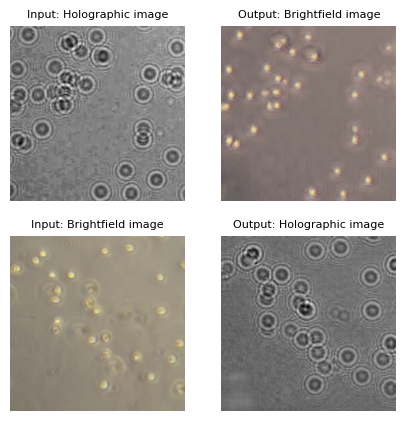



Epoch 82/100
----------
Batch 1/110 : Generator Loss: 2.4135, Discriminator Loss: 0.1907
Batch 21/110 : Generator Loss: 2.0451, Discriminator Loss: 0.1990
Batch 41/110 : Generator Loss: 2.0046, Discriminator Loss: 0.2950
Batch 61/110 : Generator Loss: 2.0692, Discriminator Loss: 0.2266
Batch 81/110 : Generator Loss: 2.1912, Discriminator Loss: 0.1820
Batch 101/110 : Generator Loss: 2.2599, Discriminator Loss: 0.1346
----------
Epoch 82/100 : Generator Loss: 2.1447, Discriminator Loss: 0.1934
Time taken: 0:00:35.132618


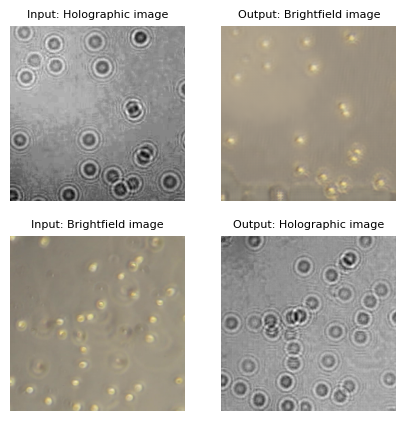



Epoch 83/100
----------
Batch 1/110 : Generator Loss: 2.1391, Discriminator Loss: 0.1308
Batch 21/110 : Generator Loss: 2.4709, Discriminator Loss: 0.1630
Batch 41/110 : Generator Loss: 1.9556, Discriminator Loss: 0.2634
Batch 61/110 : Generator Loss: 2.3188, Discriminator Loss: 0.1311
Batch 81/110 : Generator Loss: 1.8031, Discriminator Loss: 0.1954
Batch 101/110 : Generator Loss: 2.3102, Discriminator Loss: 0.1296
----------
Epoch 83/100 : Generator Loss: 2.1230, Discriminator Loss: 0.2024
Time taken: 0:00:35.141783


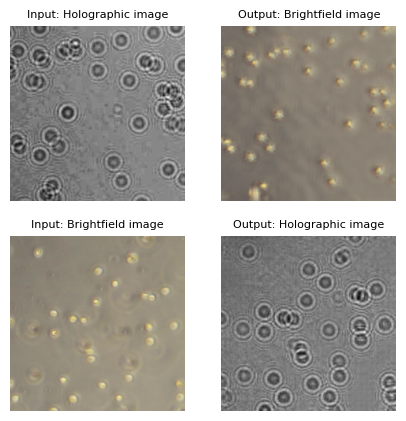



Epoch 84/100
----------
Batch 1/110 : Generator Loss: 2.0889, Discriminator Loss: 0.2717
Batch 21/110 : Generator Loss: 2.0672, Discriminator Loss: 0.3648
Batch 41/110 : Generator Loss: 1.9993, Discriminator Loss: 0.2073
Batch 61/110 : Generator Loss: 2.1837, Discriminator Loss: 0.1359
Batch 81/110 : Generator Loss: 2.1603, Discriminator Loss: 0.2770
Batch 101/110 : Generator Loss: 2.1264, Discriminator Loss: 0.1127
----------
Epoch 84/100 : Generator Loss: 2.1121, Discriminator Loss: 0.2241
Time taken: 0:00:35.134226


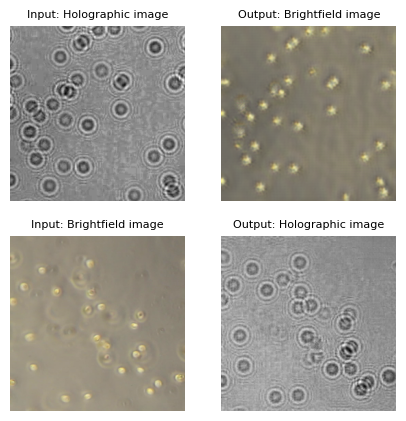



Epoch 85/100
----------
Batch 1/110 : Generator Loss: 2.0958, Discriminator Loss: 0.2027
Batch 21/110 : Generator Loss: 2.0667, Discriminator Loss: 0.1365
Batch 41/110 : Generator Loss: 1.9132, Discriminator Loss: 0.1632
Batch 61/110 : Generator Loss: 1.9439, Discriminator Loss: 0.2938
Batch 81/110 : Generator Loss: 1.9487, Discriminator Loss: 0.2177
Batch 101/110 : Generator Loss: 2.0567, Discriminator Loss: 0.2492
----------
Epoch 85/100 : Generator Loss: 2.0867, Discriminator Loss: 0.2123
Time taken: 0:00:35.148326


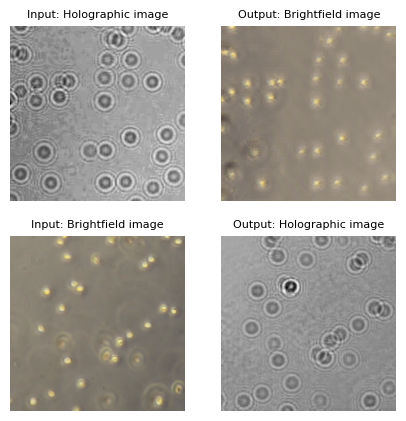



Epoch 86/100
----------
Batch 1/110 : Generator Loss: 2.0073, Discriminator Loss: 0.1882
Batch 21/110 : Generator Loss: 2.0928, Discriminator Loss: 0.1154
Batch 41/110 : Generator Loss: 2.0661, Discriminator Loss: 0.1586
Batch 61/110 : Generator Loss: 2.3247, Discriminator Loss: 0.1457
Batch 81/110 : Generator Loss: 2.1654, Discriminator Loss: 0.1594
Batch 101/110 : Generator Loss: 2.0194, Discriminator Loss: 0.2140
----------
Epoch 86/100 : Generator Loss: 2.1127, Discriminator Loss: 0.1699
Time taken: 0:00:35.189351


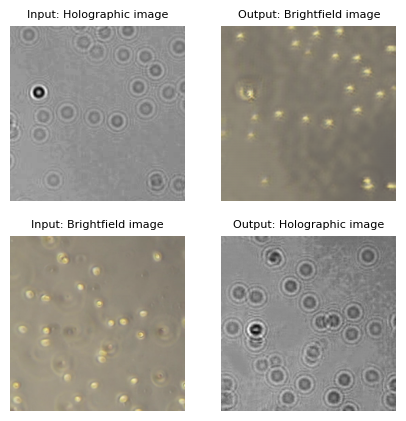



Epoch 87/100
----------
Batch 1/110 : Generator Loss: 2.0029, Discriminator Loss: 0.2157
Batch 61/110 : Generator Loss: 2.2755, Discriminator Loss: 0.2363
Batch 81/110 : Generator Loss: 2.0410, Discriminator Loss: 0.1558
Batch 101/110 : Generator Loss: 2.0796, Discriminator Loss: 0.2097
----------
Epoch 89/100 : Generator Loss: 2.0781, Discriminator Loss: 0.1907
Time taken: 0:00:35.194138


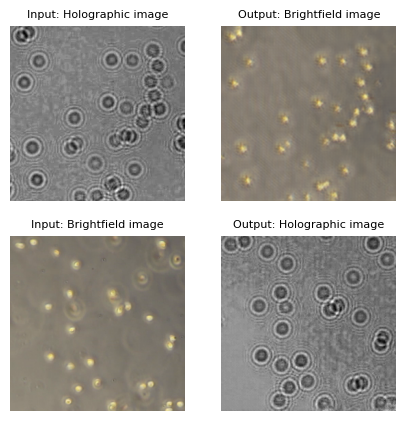



Epoch 90/100
----------
Batch 1/110 : Generator Loss: 2.1203, Discriminator Loss: 0.1433
Batch 21/110 : Generator Loss: 2.1548, Discriminator Loss: 0.1431
Batch 41/110 : Generator Loss: 2.1691, Discriminator Loss: 0.1144
Batch 61/110 : Generator Loss: 2.1087, Discriminator Loss: 0.1342
Batch 81/110 : Generator Loss: 2.1062, Discriminator Loss: 0.1223
Batch 101/110 : Generator Loss: 1.9204, Discriminator Loss: 0.1482
----------
Epoch 90/100 : Generator Loss: 2.0656, Discriminator Loss: 0.1836
Time taken: 0:00:35.164479


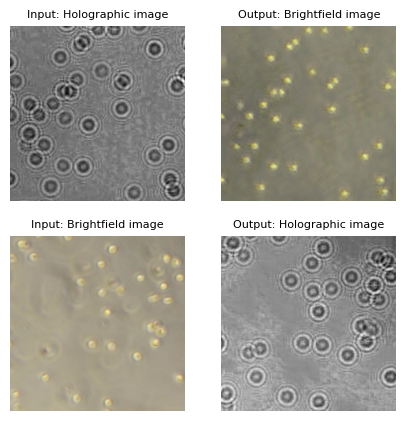



Epoch 91/100
----------
Batch 1/110 : Generator Loss: 2.2834, Discriminator Loss: 0.1913
Batch 21/110 : Generator Loss: 1.9875, Discriminator Loss: 0.1846
Batch 41/110 : Generator Loss: 2.0976, Discriminator Loss: 0.1643
Batch 61/110 : Generator Loss: 2.2551, Discriminator Loss: 0.2018
Batch 81/110 : Generator Loss: 2.1794, Discriminator Loss: 0.1794
Batch 101/110 : Generator Loss: 1.8278, Discriminator Loss: 0.2841
----------
Epoch 91/100 : Generator Loss: 2.1033, Discriminator Loss: 0.1689
Time taken: 0:00:35.141820


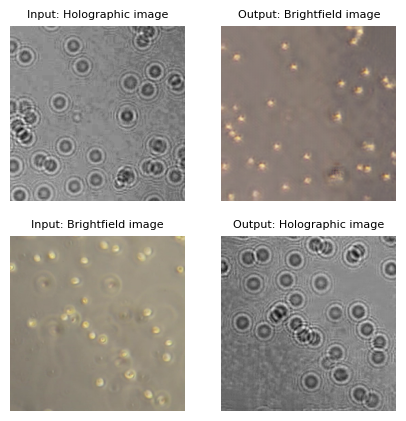



Epoch 92/100
----------
Batch 1/110 : Generator Loss: 2.4112, Discriminator Loss: 0.0675
Batch 21/110 : Generator Loss: 2.0910, Discriminator Loss: 0.1770
Batch 41/110 : Generator Loss: 1.8792, Discriminator Loss: 0.2240
Batch 61/110 : Generator Loss: 2.1728, Discriminator Loss: 0.1099
Batch 81/110 : Generator Loss: 1.9448, Discriminator Loss: 0.2253
Batch 101/110 : Generator Loss: 1.9893, Discriminator Loss: 0.2238
----------
Epoch 92/100 : Generator Loss: 2.1286, Discriminator Loss: 0.1690
Time taken: 0:00:35.106353


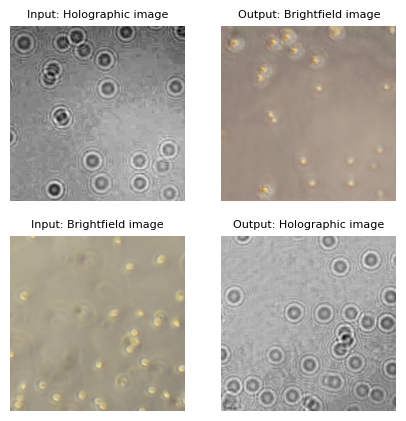



Epoch 93/100
----------
Batch 1/110 : Generator Loss: 2.1287, Discriminator Loss: 0.1235
Batch 21/110 : Generator Loss: 2.2475, Discriminator Loss: 0.0875
Batch 41/110 : Generator Loss: 2.2874, Discriminator Loss: 0.0860
Batch 61/110 : Generator Loss: 2.1536, Discriminator Loss: 0.1127
Batch 81/110 : Generator Loss: 1.9537, Discriminator Loss: 0.1536
Batch 101/110 : Generator Loss: 2.0333, Discriminator Loss: 0.1464
----------
Epoch 93/100 : Generator Loss: 2.1653, Discriminator Loss: 0.1598
Time taken: 0:00:35.079399


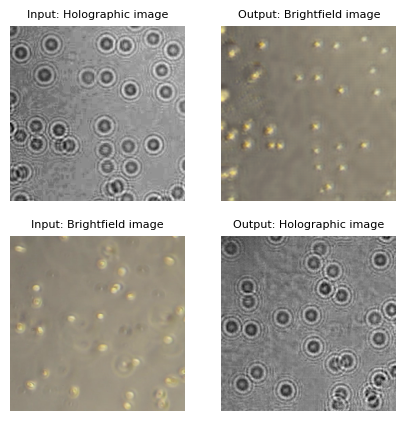



Epoch 94/100
----------
Batch 1/110 : Generator Loss: 1.9137, Discriminator Loss: 0.2391
Batch 21/110 : Generator Loss: 2.1317, Discriminator Loss: 0.2557
Batch 41/110 : Generator Loss: 2.2623, Discriminator Loss: 0.2111
Batch 61/110 : Generator Loss: 1.8600, Discriminator Loss: 0.1798
Batch 81/110 : Generator Loss: 2.1177, Discriminator Loss: 0.1873
Batch 101/110 : Generator Loss: 2.1310, Discriminator Loss: 0.2055
----------
Epoch 94/100 : Generator Loss: 2.1170, Discriminator Loss: 0.1709
Time taken: 0:00:35.157774


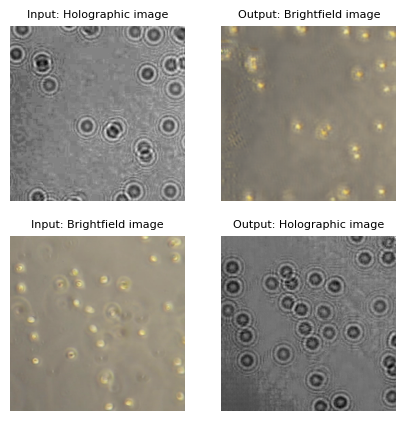



Epoch 95/100
----------
Batch 1/110 : Generator Loss: 2.1970, Discriminator Loss: 0.1500
Batch 21/110 : Generator Loss: 2.1242, Discriminator Loss: 0.1489
Batch 41/110 : Generator Loss: 2.0985, Discriminator Loss: 0.1352
Batch 61/110 : Generator Loss: 2.0529, Discriminator Loss: 0.3243
Batch 81/110 : Generator Loss: 1.9741, Discriminator Loss: 0.1994
Batch 101/110 : Generator Loss: 1.8379, Discriminator Loss: 0.1487
----------
Epoch 95/100 : Generator Loss: 2.1045, Discriminator Loss: 0.1550
Time taken: 0:00:35.125555


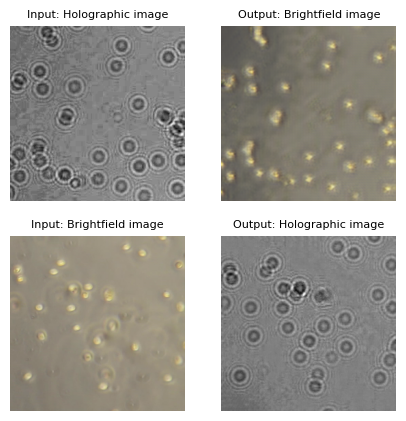



Epoch 96/100
----------
Batch 1/110 : Generator Loss: 2.0406, Discriminator Loss: 0.2122
Batch 21/110 : Generator Loss: 2.1388, Discriminator Loss: 0.1608
Batch 41/110 : Generator Loss: 2.2177, Discriminator Loss: 0.5091
Batch 61/110 : Generator Loss: 2.3844, Discriminator Loss: 0.1726
Batch 81/110 : Generator Loss: 2.3259, Discriminator Loss: 0.0554
Batch 101/110 : Generator Loss: 2.1175, Discriminator Loss: 0.1249
----------
Epoch 96/100 : Generator Loss: 2.1365, Discriminator Loss: 0.1675
Time taken: 0:00:35.087391


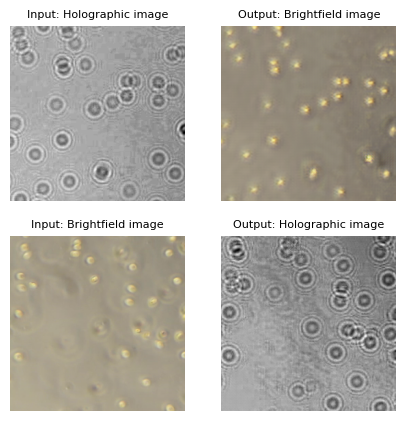



Epoch 97/100
----------
Batch 1/110 : Generator Loss: 2.0991, Discriminator Loss: 0.1883
Batch 21/110 : Generator Loss: 2.2216, Discriminator Loss: 0.1040
Batch 41/110 : Generator Loss: 2.1237, Discriminator Loss: 0.1649
Batch 61/110 : Generator Loss: 2.2830, Discriminator Loss: 0.0969
Batch 81/110 : Generator Loss: 2.0025, Discriminator Loss: 0.1879
Batch 101/110 : Generator Loss: 2.0589, Discriminator Loss: 0.1602
----------
Epoch 97/100 : Generator Loss: 2.1303, Discriminator Loss: 0.1223
Time taken: 0:00:35.095491


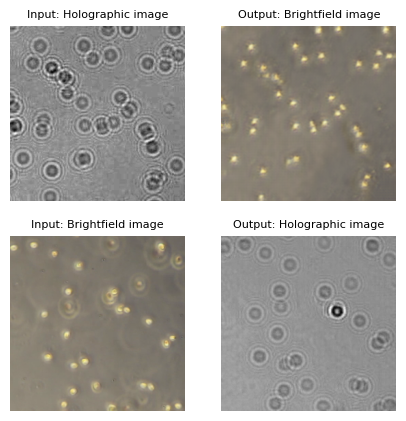



Epoch 98/100
----------
Batch 1/110 : Generator Loss: 2.0137, Discriminator Loss: 0.2506
Batch 21/110 : Generator Loss: 2.2317, Discriminator Loss: 0.1863
Batch 41/110 : Generator Loss: 2.0213, Discriminator Loss: 0.1276
Batch 61/110 : Generator Loss: 2.1083, Discriminator Loss: 0.0877
Batch 81/110 : Generator Loss: 2.0623, Discriminator Loss: 0.1158
Batch 101/110 : Generator Loss: 2.0857, Discriminator Loss: 0.1401
----------
Epoch 98/100 : Generator Loss: 2.1563, Discriminator Loss: 0.1230
Time taken: 0:00:35.125230


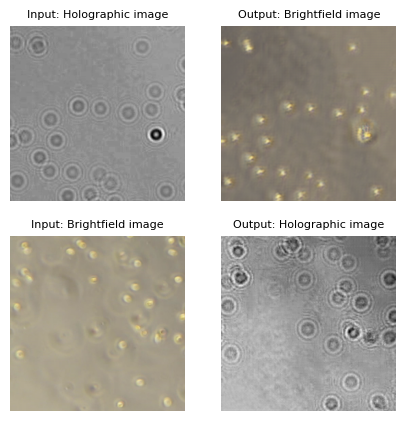



Epoch 99/100
----------
Batch 1/110 : Generator Loss: 2.1876, Discriminator Loss: 0.1158
Batch 21/110 : Generator Loss: 2.0420, Discriminator Loss: 0.1780
Batch 41/110 : Generator Loss: 2.2318, Discriminator Loss: 0.2557
Batch 61/110 : Generator Loss: 2.4759, Discriminator Loss: 0.3252
Batch 81/110 : Generator Loss: 2.1693, Discriminator Loss: 0.0797
Batch 101/110 : Generator Loss: 2.3392, Discriminator Loss: 0.1313
----------
Epoch 99/100 : Generator Loss: 2.1459, Discriminator Loss: 0.1451
Time taken: 0:00:35.090981


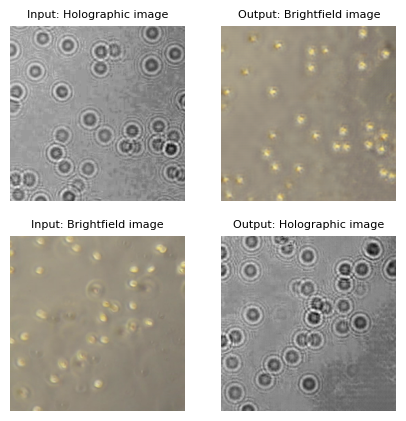



Epoch 100/100
----------
Batch 1/110 : Generator Loss: 1.9026, Discriminator Loss: 0.1755
Batch 21/110 : Generator Loss: 2.3576, Discriminator Loss: 0.1105
Batch 41/110 : Generator Loss: 2.0601, Discriminator Loss: 0.1121
Batch 61/110 : Generator Loss: 2.1741, Discriminator Loss: 0.1944
Batch 81/110 : Generator Loss: 2.1676, Discriminator Loss: 0.1220
Batch 101/110 : Generator Loss: 2.1106, Discriminator Loss: 0.1029
----------
Epoch 100/100 : Generator Loss: 2.1218, Discriminator Loss: 0.1463
Time taken: 0:00:35.115525


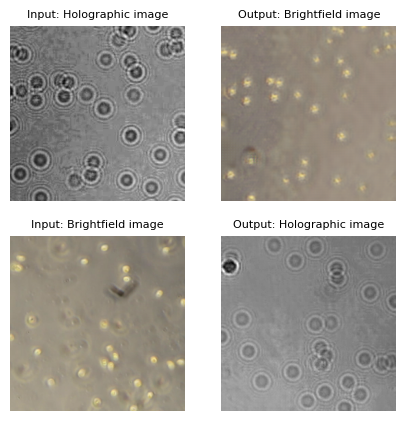

In [12]:
# Train the CycleGAN
EPOCHS = 100

# Import the packages required for checking the time taken for each epoch
import time
from datetime import timedelta

# Create empty lists to store the generator and discriminator losses for each epoch
genreator_loss = []
discriminator_loss = []

# Training loop
for epoch in range(EPOCHS):
    # Record the start time of each epoch
    start_time = time.time()

    n_batches = len(trainloader)


    print("\n")
    print(f"Epoch {epoch+1}/{EPOCHS}")
    print("-" * 10)

    # looping over batches
    G_loss_epochs = []
    D_loss_epochs = []

    for i, data in enumerate(trainloader, 0):
        # get the domain A and B images for each batch

        inputs_A, inputs_B = data
        inputs_A, inputs_B = inputs_A.to(device), inputs_B.to(device)

        # Train the model
        disc_loss, gen_loss = train_model(
            input_image_A=inputs_A, input_image_B=inputs_B, optimizer_disc=optimizer_D, optimizer_gen=optimizer_G, L1_LambdaA=10, L1_LambdaB=5
        )

        # Print the loss for this batch
        if i % 20 == 0:
            print(
                f"Batch {i+1}/{n_batches} : Generator Loss: {gen_loss.item():.4f}, Discriminator Loss: {disc_loss.item():.4f}"
            )

        # Save the loss for this batch
        G_loss_epochs.append(gen_loss.item())
        D_loss_epochs.append(disc_loss.item())

    # Record the end time of each epoch
    end_time = time.time()

    # Print the loss for this epoch
    print("-" * 10)
    print(
        f"Epoch {epoch+1}/{EPOCHS} : Generator Loss: {np.mean(G_loss_epochs):.4f}, Discriminator Loss: {np.mean(D_loss_epochs):.4f}"
    )
    print(f"Time taken: {timedelta(seconds=end_time-start_time)}")

    if epoch % 1 == 0:
        for i, data in enumerate(testloader, 0):
            # get the domain A and B images for each batch
            test_inputs_A, test_inputs_B = data
            test_inputs_A, test_inputs_B = test_inputs_A.to(device), test_inputs_B.to(
                device
            )
            break

        # Evaluate the model
        fig = evaluate_model(test_inputs_A, test_inputs_B)
        plt.show()

    # Save the loss for this epoch
    genreator_loss.append(np.mean(G_loss_epochs))
    discriminator_loss.append(np.mean(D_loss_epochs))

    del inputs_A, inputs_B, disc_loss, gen_loss

### Plot losses

We will now plot the losses of the generator and discriminator networks. Try comparing the results above to the inflection of the losses below.

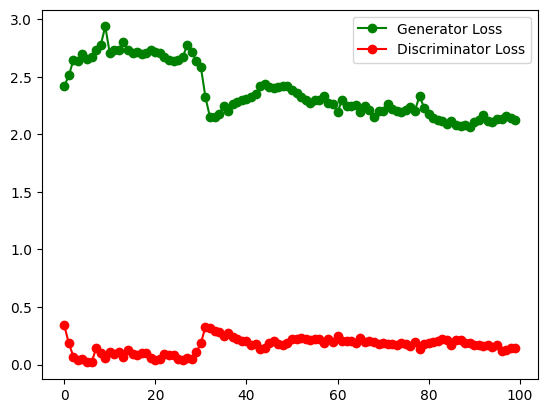

In [13]:
import numpy as np

plt.figure()
plt.plot(np.arange(len(genreator_loss)), genreator_loss, "g-o", label="Generator Loss")
plt.plot(
    np.arange(len(discriminator_loss)), discriminator_loss, "r-o", label="Discriminator Loss"
)
plt.legend()
plt.show()